In [1]:
import os
os.chdir('/data2/zhouwg_data/project/Garfield')
os.getcwd()

# load packages
import warnings
import Garfield as gf
import scanpy as sc
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

In [2]:
## 读取数据
ref_adata = sc.read_h5ad('/data2/zhouwg_data/bioData/Bio_OS_Data/ref_adata/snRNA_ref_brain_final.h5ad')
ref_adata

AnnData object with n_obs × n_vars = 39208 × 31053
    obs: 'Batch', 'sample', 'annotation_1', 'annotation_1_print', 'MajorCelltype', 'MinCelltype'

In [3]:
### Integrating reference data using Garfield
# set workdir
workdir = 'snRNA_barin_with_Garfield2'
gf.settings.set_workdir(workdir)

Saving results in: snRNA_barin_with_Garfield2


In [4]:
### modify parameter
user_config = dict(
    ## Input options
    adata_list=ref_adata,  # STR     adata object of single-cell dataset.         Default is `adata`.
    profile='RNA',   # STR     Type of single-cell dataset.                  Default is `RNA`.
    data_type=None,
    sample_col='Batch',  # STR     Column name of sample in adata.obs.       Default is `batch`.
    weight=0.5,

    ## Preprocessing options
    graph_const_method='mu_std',
    genome=None,
    use_gene_weight=True,
    use_top_pcs=False,
    used_hvg=True,
    min_cells=3,
    min_features=0,
    keep_mt=False,
    target_sum=1e4,
    rna_n_top_features=3000,
    atac_n_top_features=10000,
    n_components=50,
    n_neighbors=5,
    metric='euclidean',  # STR     Metric for clustering.                   Default is `euclidean`.
    svd_solver='arpack',
    # datasets
    adj_key='connectivities', # spatial_connectivities connectivities

    # data split parameters
    edge_val_ratio=0.1,
    edge_test_ratio=0.,
    node_val_ratio=0.1,
    node_test_ratio=0.,

    ## Model options
    use_FCencoder=True,
    conv_type='GATv2Conv', # GAT or GATv2Conv or GCN
    gnn_layer=2,
    hidden_dims=[128, 128],
    bottle_neck_neurons=20,
    drop_feature_rate=0.2,
    drop_edge_rate=0.2,
    num_heads=3,
    dropout=0.2,
    concat=True,
    used_edge_weight=False,
    used_DSBN=False,
    used_mmd=False,
    # data loader parameters
    # loader_type='graphsaint', # neighbor graphsaint dataLoader
    num_neighbors=5,
    loaders_n_hops=2,
    edge_batch_size=4096,
    node_batch_size=64, # None
    # loss parameters
    include_edge_recon_loss=True,
    include_gene_expr_recon_loss=True,
    lambda_latent_contrastive_loss=1.0,
    lambda_gene_expr_recon=300.,
    lambda_edge_recon=500000.,
    lambda_omics_recon_mmd_loss=1.0,
    # train parameters
    n_epochs_no_edge_recon=0,
    learning_rate=0.001,
    weight_decay=1e-05,
    gradient_clipping=5,
    # other parameters
    latent_key='garfield_latent',
    reload_best_model=True,
    use_early_stopping=True,
    early_stopping_kwargs=None,
    monitor=True,
    seed=2024,
    verbose=True
)
dict_config = gf.settings.set_gf_params(user_config)

In [5]:
from Garfield.model import Garfield

# Initialize model
model = Garfield(dict_config)
# Train model
model.train()

--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 35287
Number of validation nodes: 3921
Number of training edges: 115722
Number of validation edges: 12857
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9567; val_auprc_score: 0.9454; val_best_acc_score: 0.8589; val_best_f1_score: 0.8750; train_kl_reg_loss: 449.5251; train_edge_recon_loss: 308360.1509; train_gene_expr_recon_loss: 65.4766; train_latent_contrastive_loss: 4.5198; train_global_loss: 308879.6778; train_optim_loss: 308879.6778; val_kl_reg_loss: 736.1839; val_edge_recon_loss: 279801.4609; val_gene_expr_recon_loss: 49.9420; val_latent_contrastive_loss: 4.2763; val_global_loss: 280591.8672; val_optim_loss: 280591.8672
Epoch 2/100 |--------------------| 2.0% val_auroc_score: 0.9434; val_auprc_score: 0.9201; val_best_acc_score: 0.9036; val_best_f1_score: 0.9113; tr

In [6]:
# Compute latent neighbor graph
latent_key = 'garfield_latent'
sc.pp.neighbors(model.adata,
                use_rep=latent_key,
                key_added=latent_key)
# Compute UMAP embedding
sc.tl.umap(model.adata,
           neighbors_key=latent_key)

In [7]:
model.adata

AnnData object with n_obs × n_vars = 39208 × 3000
    obs: 'Batch', 'sample', 'annotation_1', 'annotation_1_print', 'MajorCelltype', 'MinCelltype', 'n_genes'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'garfield_latent', 'umap'
    obsm: 'X_pca', 'feat', 'garfield_latent', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'norm_data'
    obsp: 'distances', 'connectivities', 'garfield_latent_distances', 'garfield_latent_connectivities'

In [8]:
# Save trained model
model_folder_path = f"{workdir}/model"
os.makedirs(model_folder_path, exist_ok=True)

model.save(dir_path=model_folder_path,
           overwrite=True,
           save_adata=True,
           adata_file_name="adata_ref.h5ad")

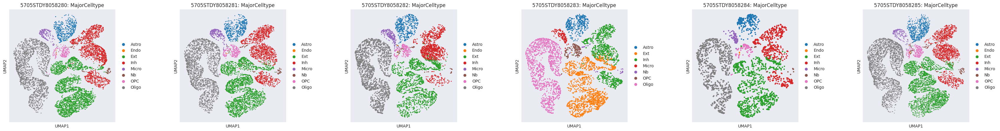

In [9]:
# 实现细胞类型umap图按样本分面
import matplotlib.pyplot as plt

split = model.adata.obs['sample'].unique().tolist()
n_split = len(split)
fig, ax = plt.subplots(nrows=1, ncols=n_split, squeeze=False, figsize=(7 * n_split, 5))

for i in range(n_split):
     tmp = model.adata[model.adata.obs['sample'] == split[i], :]
     sc.pl.umap(tmp, color='MajorCelltype', ax=ax[0, i], show=False)
     ax[0, i].set_title(f"{split[i]}: MajorCelltype")

plt.subplots_adjust(wspace=0.6)
fig.show()

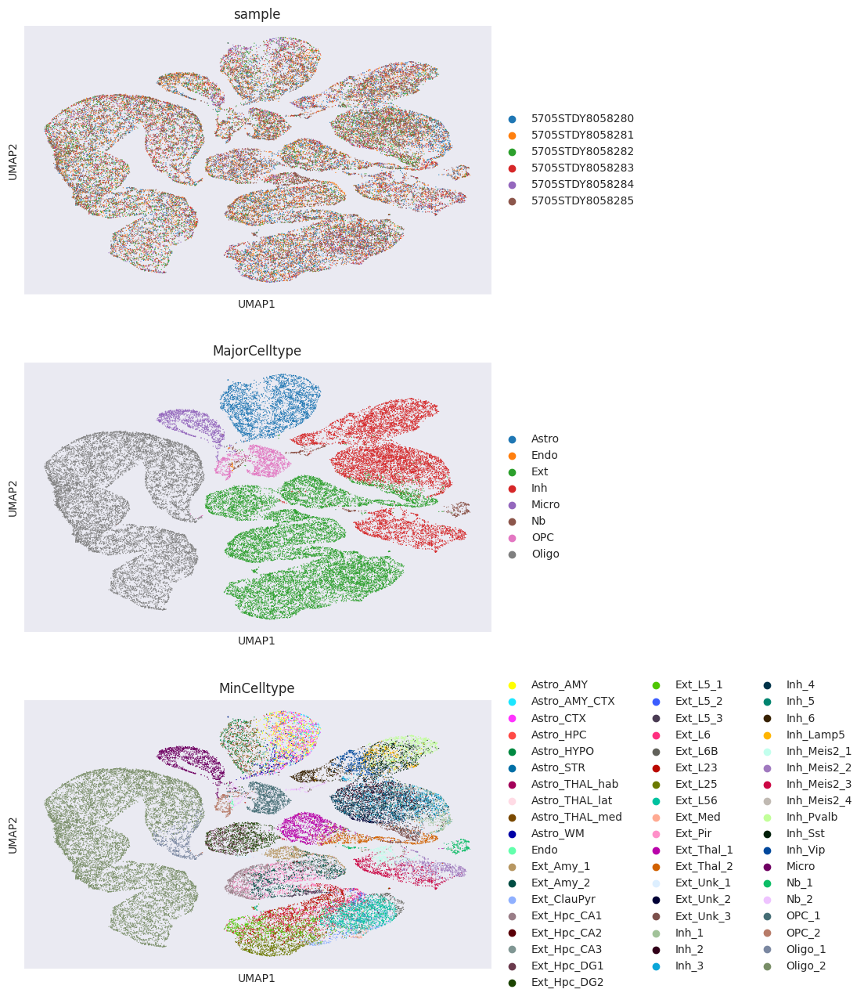

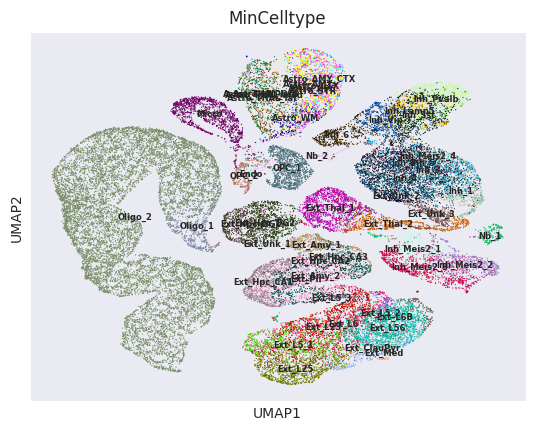

In [10]:
sc.pl.umap(model.adata, color=['sample', 'MajorCelltype', 'MinCelltype'], wspace=0.30, ncols=1, save='_snRNA_ref_umap_gf.pdf')

sc.pl.umap(model.adata, color=['MinCelltype'], wspace=0.30,
           legend_loc='on data', legend_fontsize=6, save='_snRNA_ref_umap_gf_onlabel.pdf')

In [11]:
### perform surgery on reference model and fine-tune on query dataset
import os
import anndata as ad

adata_list = list()
for dataset in ['WTH1039', 'WTH1058', 'WTH1060',
                'WTH1064', 'WTH1079', 'WTH1092',
                'WTH628', 'WTH645', 'WTH647',
                'WTH665', 'WTH706', 'WTH708',
                'WTH725', 'WTH983', 'WTH985'
                ]:
    print('----------------Query data: {} ----------------- '.format(dataset))
    dir0 = '/data2/zhouwg_data/bioData/Bio_OS_Data/Data'

    adata = sc.read_h5ad(os.path.join(dir0, '{}/{}.h5ad'.format(dataset, dataset)))
    adata.var_names_make_unique()
    adata.obs_names_make_unique()
    adata.obs['Batch'] = dataset
    # sc.pl.spatial(adata, color=['Batch'], spot_size=50)
    adata_list.append(adata)

----------------Query data: WTH1039 ----------------- 
----------------Query data: WTH1058 ----------------- 
----------------Query data: WTH1060 ----------------- 
----------------Query data: WTH1064 ----------------- 
----------------Query data: WTH1079 ----------------- 
----------------Query data: WTH1092 ----------------- 
----------------Query data: WTH628 ----------------- 
----------------Query data: WTH645 ----------------- 
----------------Query data: WTH647 ----------------- 
----------------Query data: WTH665 ----------------- 
----------------Query data: WTH706 ----------------- 
----------------Query data: WTH708 ----------------- 
----------------Query data: WTH725 ----------------- 
----------------Query data: WTH983 ----------------- 
----------------Query data: WTH985 ----------------- 


Running sample: WTH1039


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 11479 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 45618
Number of validation nodes: 5069
Number of training edges: 149452
Number of validation edges: 16605
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9830; val_auprc_score: 0.9762; val_best_acc_score: 0.9465; val_best_f1_score: 0.9477; train_kl_reg_loss: 1012.7851; train_edge_recon_loss: 272936.1613; train_gene_expr_recon_loss: 137.0609; train_latent_contrastive_loss: 3.

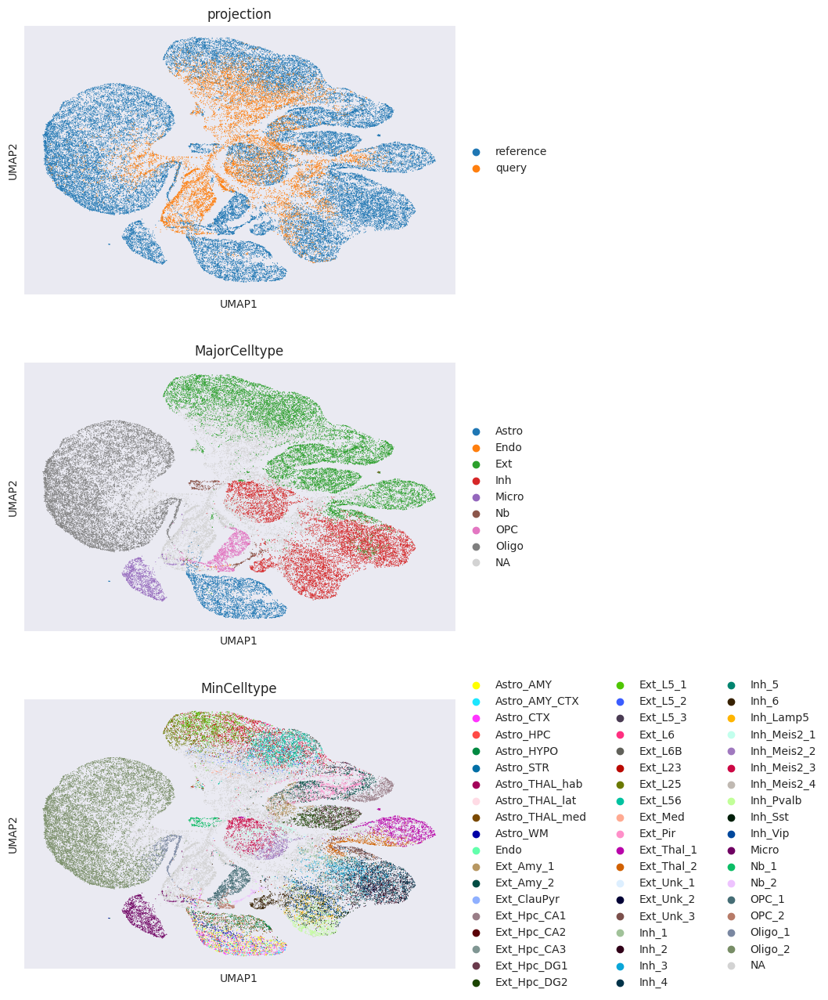

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


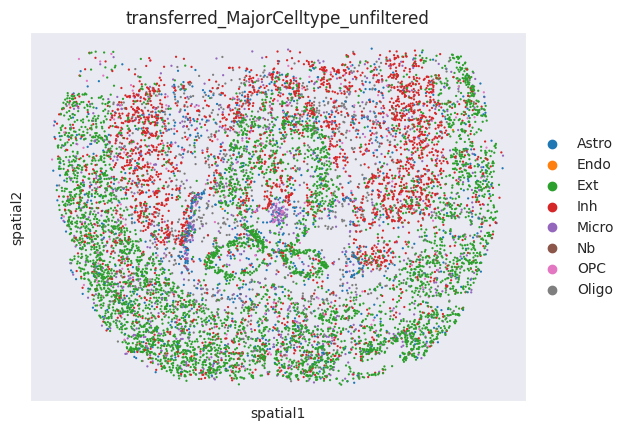

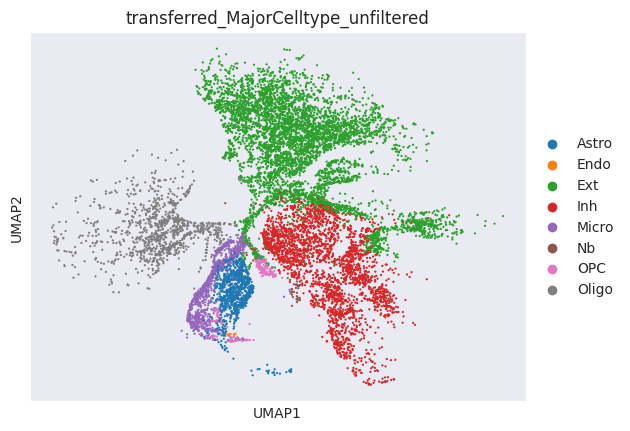

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


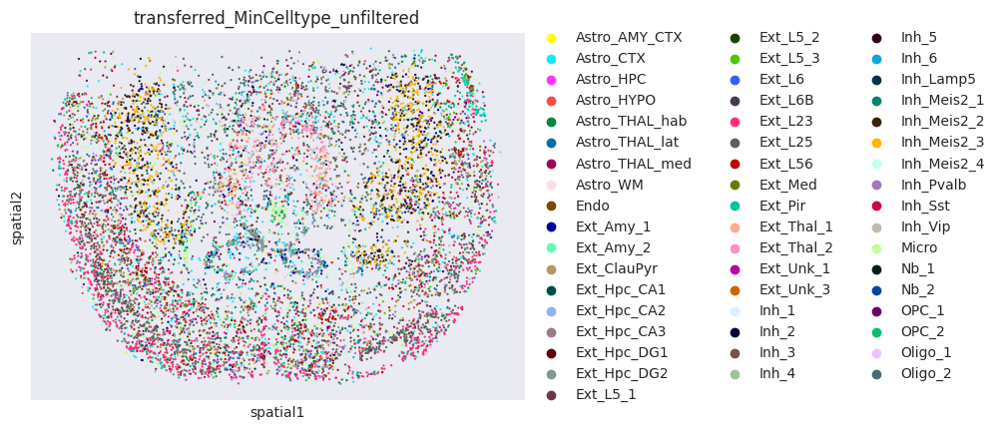

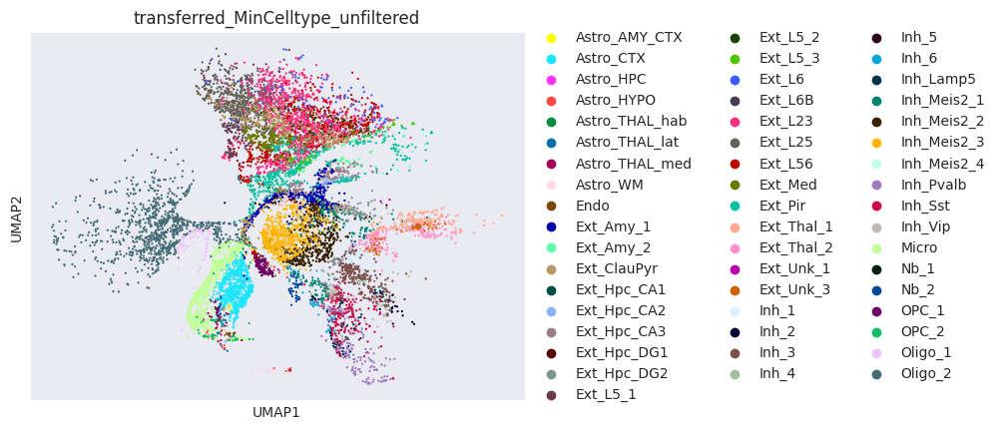

Running sample: WTH1058


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 9197 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 43565
Number of validation nodes: 4840
Number of training edges: 143407
Number of validation edges: 15934
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9824; val_auprc_score: 0.9746; val_best_acc_score: 0.9503; val_best_f1_score: 0.9516; train_kl_reg_loss: 978.5468; train_edge_recon_loss: 272973.1875; train_gene_expr_recon_loss: 128.7618; train_latent_contrastive_loss: 3.98

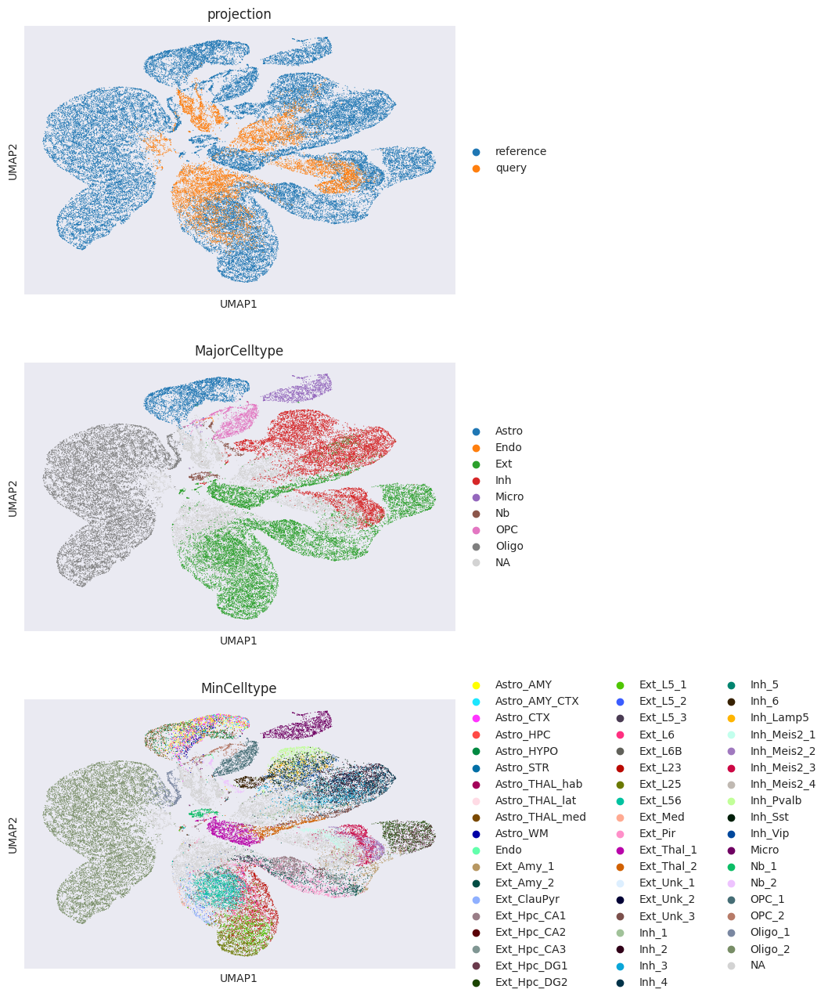

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


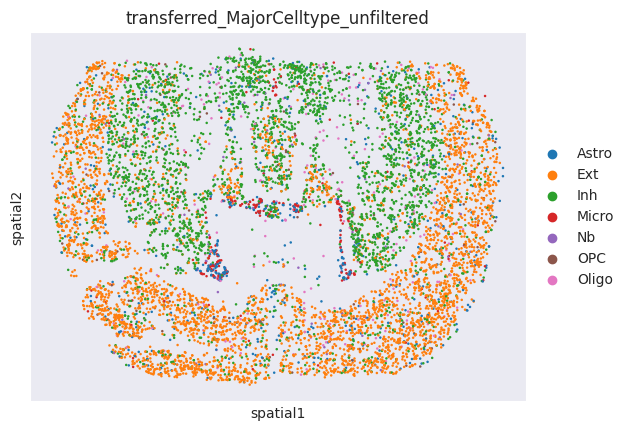

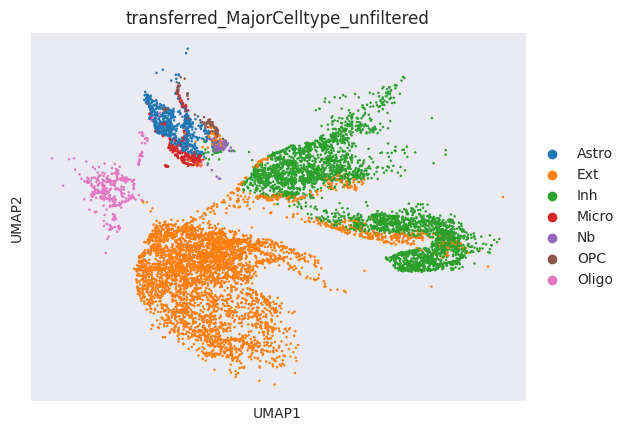

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


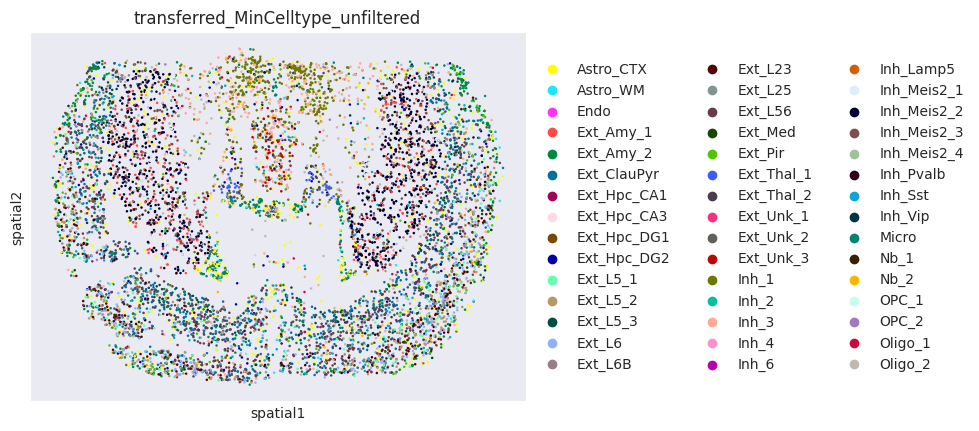

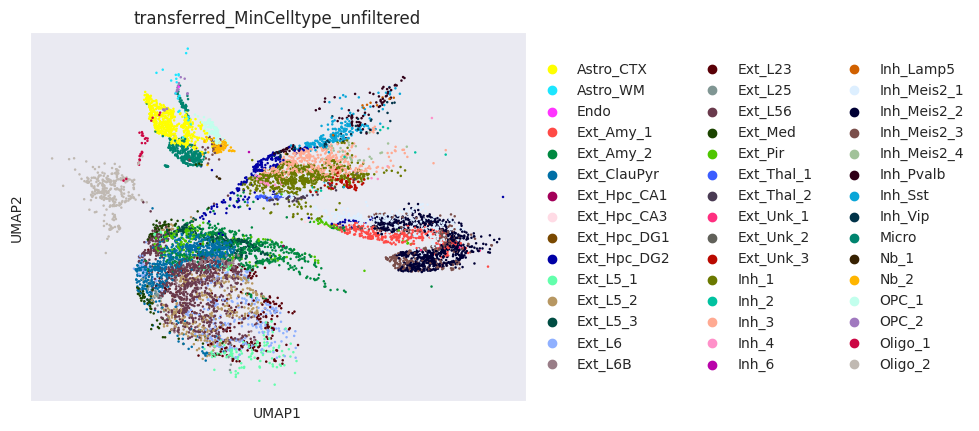

Running sample: WTH1060


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 11634 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 45758
Number of validation nodes: 5084
Number of training edges: 151061
Number of validation edges: 16784
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9820; val_auprc_score: 0.9753; val_best_acc_score: 0.9458; val_best_f1_score: 0.9471; train_kl_reg_loss: 972.1233; train_edge_recon_loss: 273258.6225; train_gene_expr_recon_loss: 127.5096; train_latent_contrastive_loss: 3.9

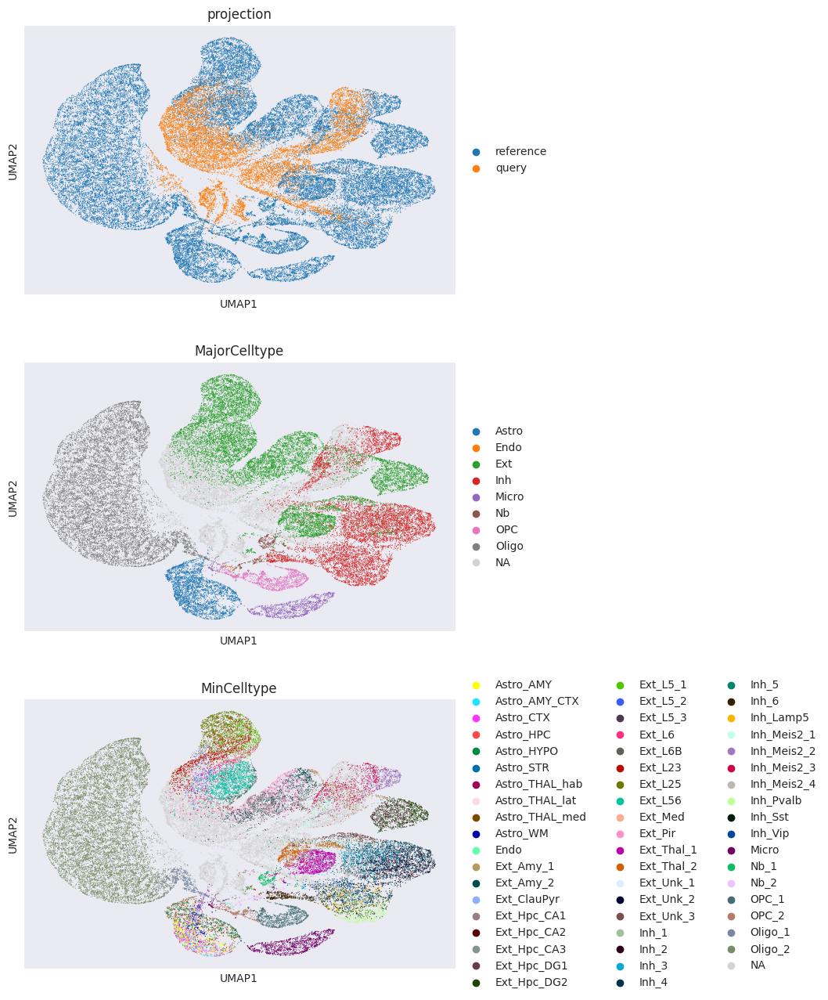

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


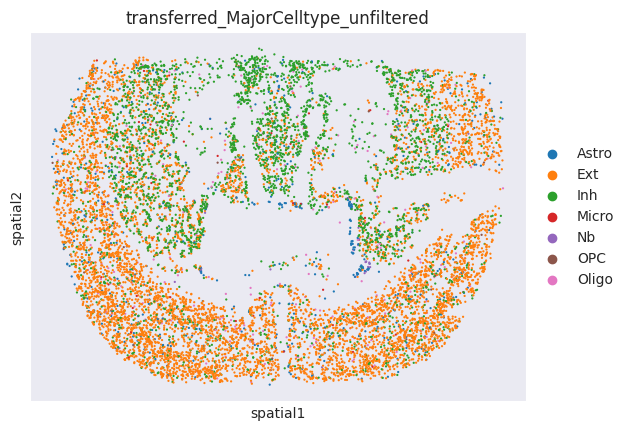

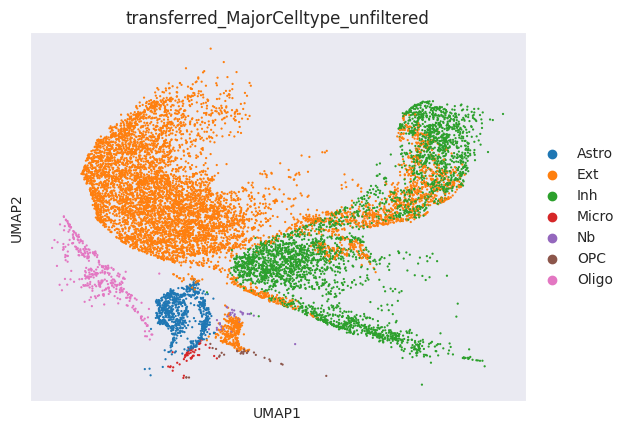

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


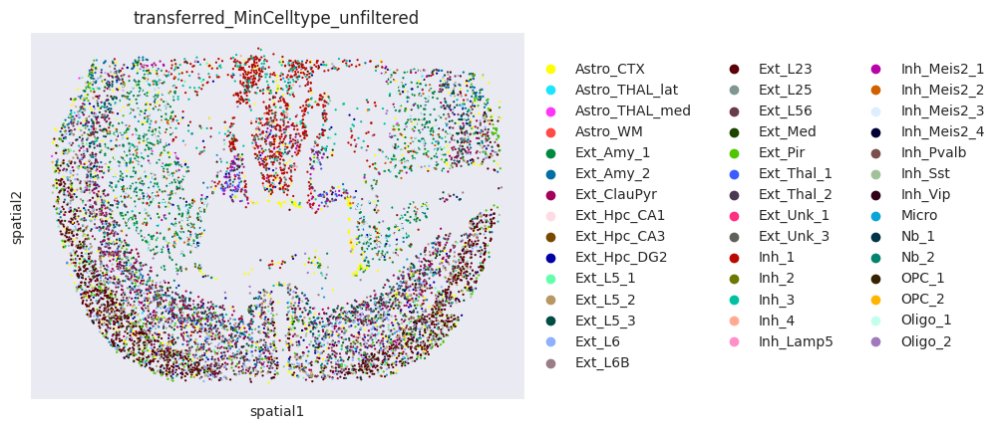

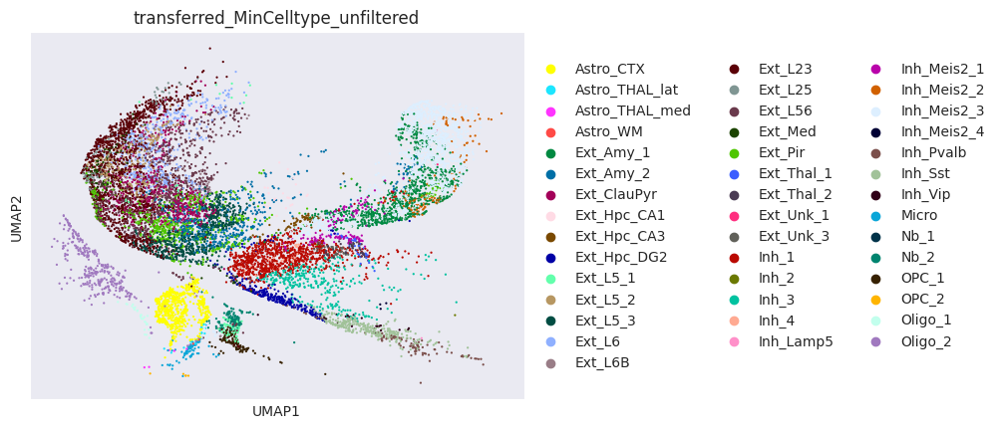

Running sample: WTH1064


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 14461 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 48302
Number of validation nodes: 5367
Number of training edges: 161766
Number of validation edges: 17974
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9787; val_auprc_score: 0.9724; val_best_acc_score: 0.9337; val_best_f1_score: 0.9352; train_kl_reg_loss: 980.0571; train_edge_recon_loss: 273705.6289; train_gene_expr_recon_loss: 122.0487; train_latent_contrastive_loss: 3.9

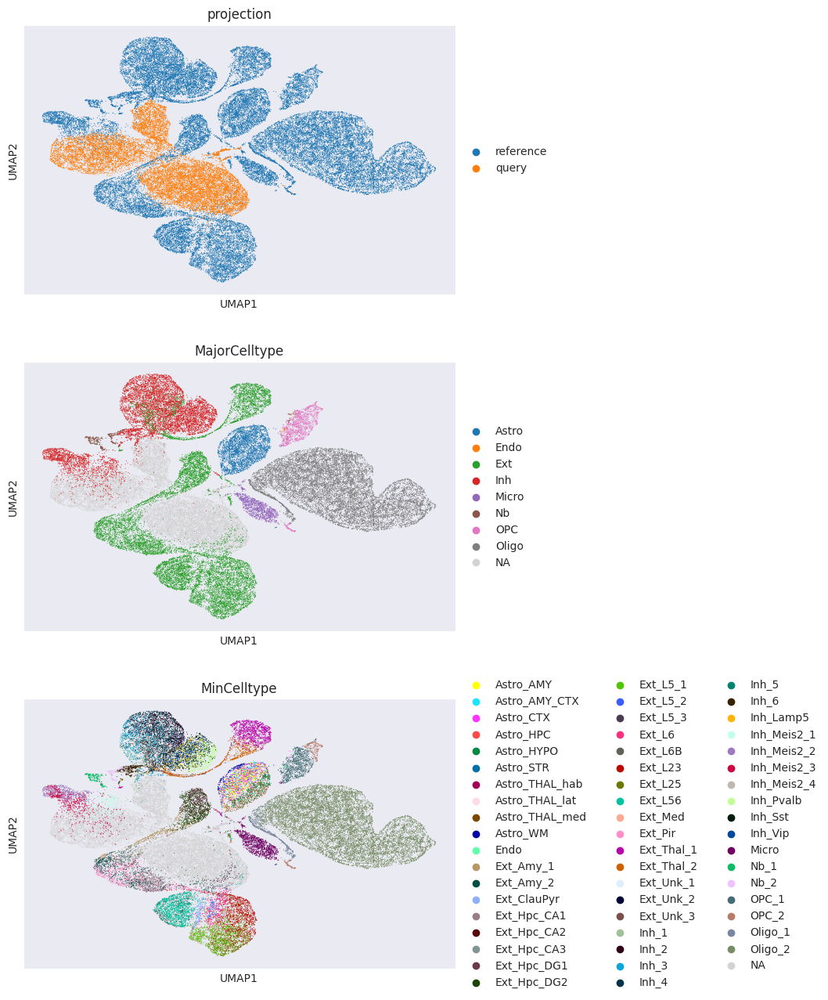

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


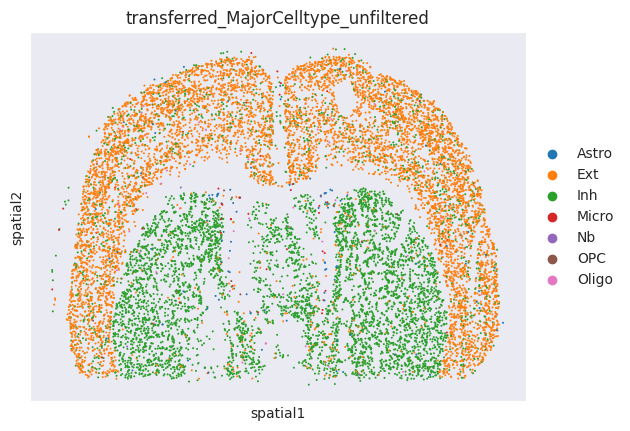

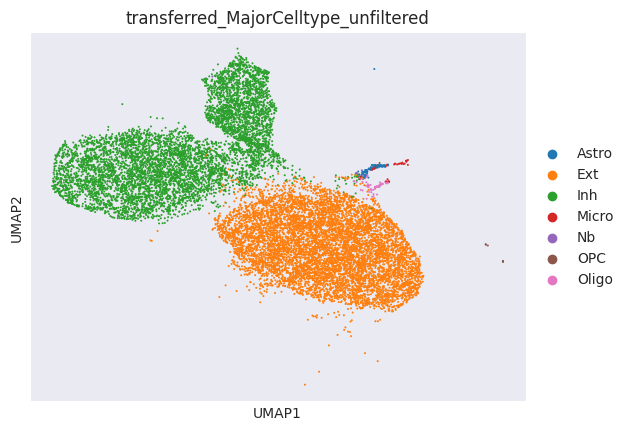

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


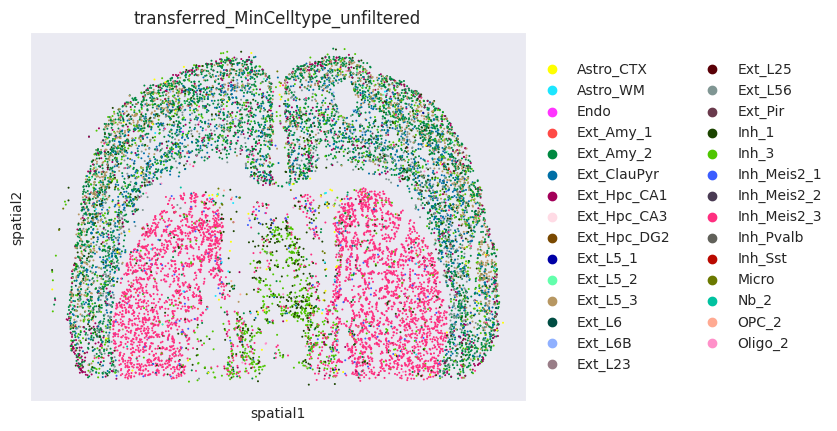

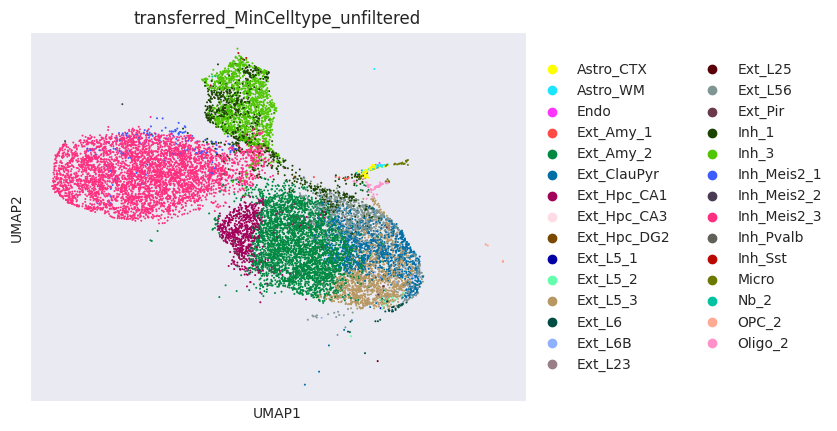

Running sample: WTH1079


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 6146 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 40819
Number of validation nodes: 4535
Number of training edges: 133759
Number of validation edges: 14862
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9831; val_auprc_score: 0.9766; val_best_acc_score: 0.9473; val_best_f1_score: 0.9485; train_kl_reg_loss: 1039.0748; train_edge_recon_loss: 272960.0511; train_gene_expr_recon_loss: 137.2958; train_latent_contrastive_loss: 3.9

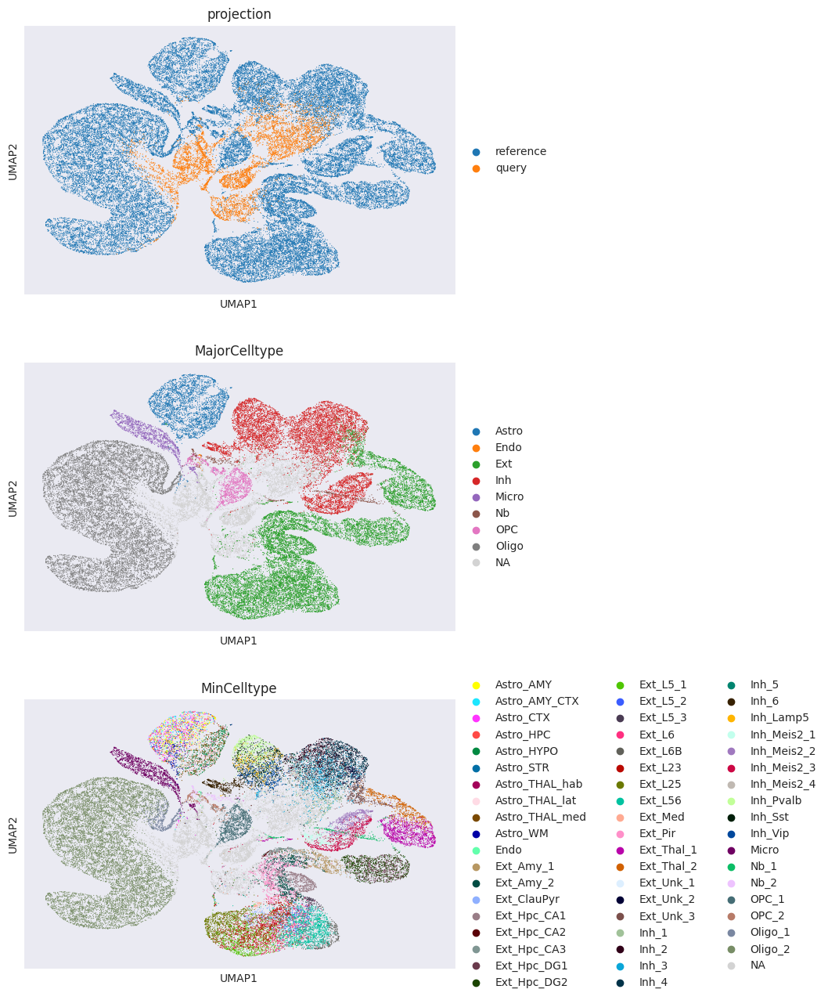

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


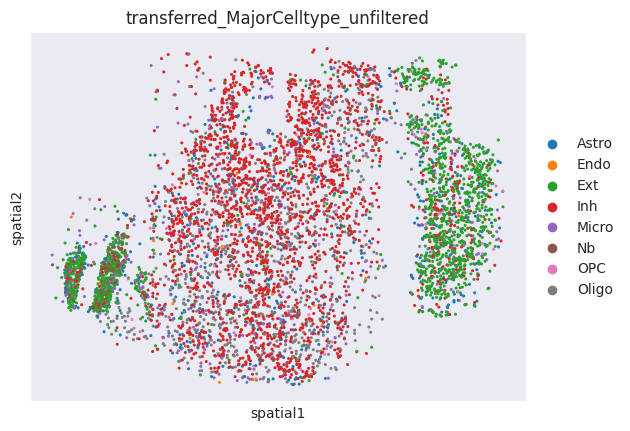

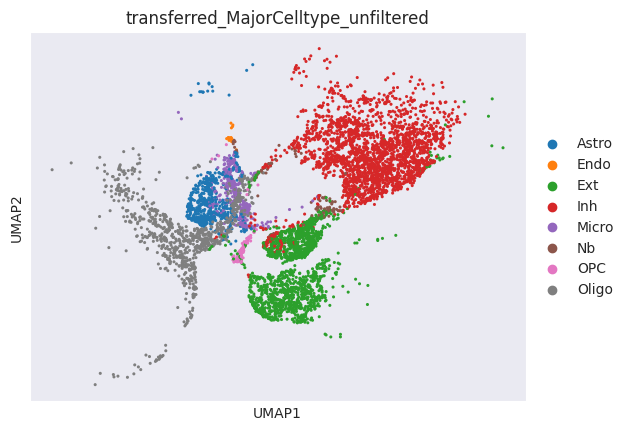

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


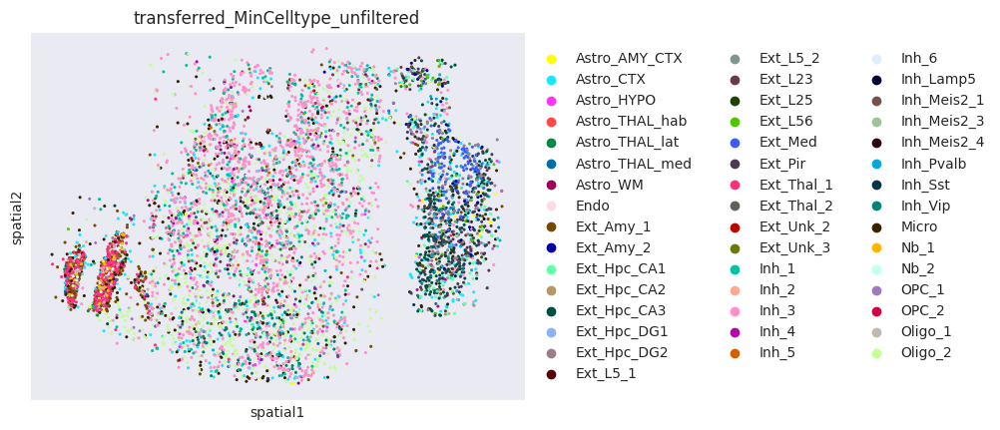

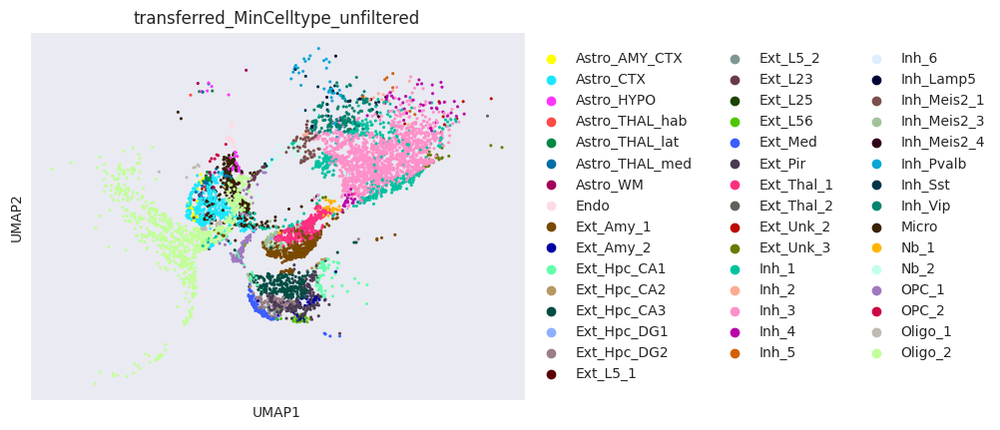

Running sample: WTH1092


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 14386 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 48235
Number of validation nodes: 5359
Number of training edges: 159750
Number of validation edges: 17750
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9798; val_auprc_score: 0.9730; val_best_acc_score: 0.9376; val_best_f1_score: 0.9389; train_kl_reg_loss: 975.8053; train_edge_recon_loss: 272721.4121; train_gene_expr_recon_loss: 130.9590; train_latent_contrastive_loss: 3.9

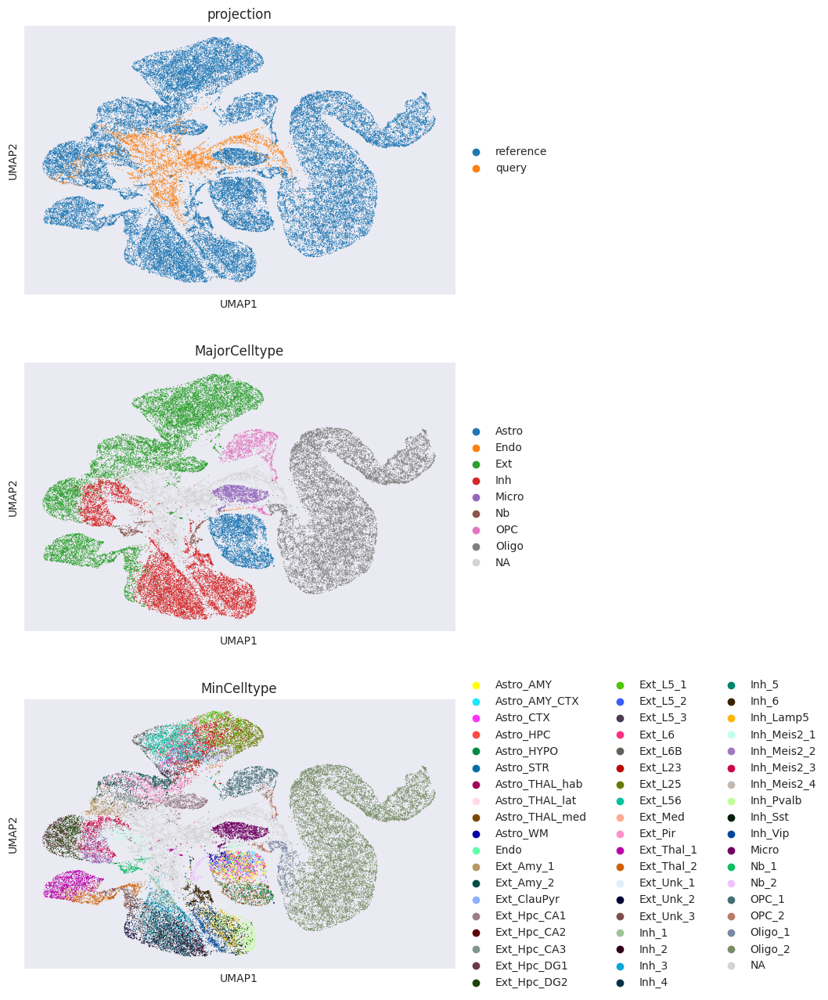

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


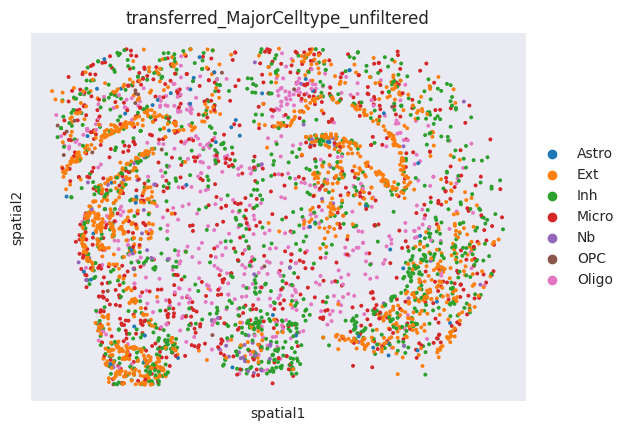

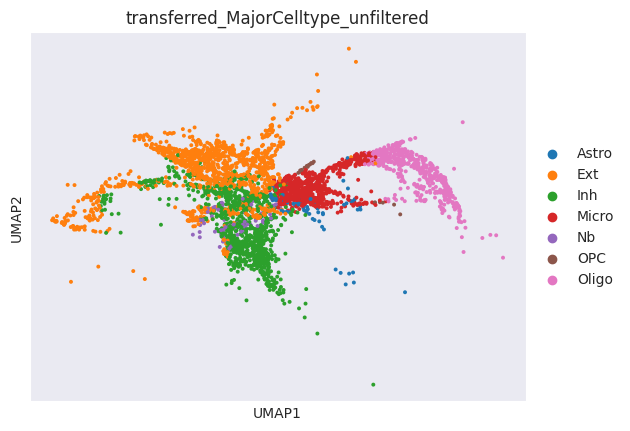

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


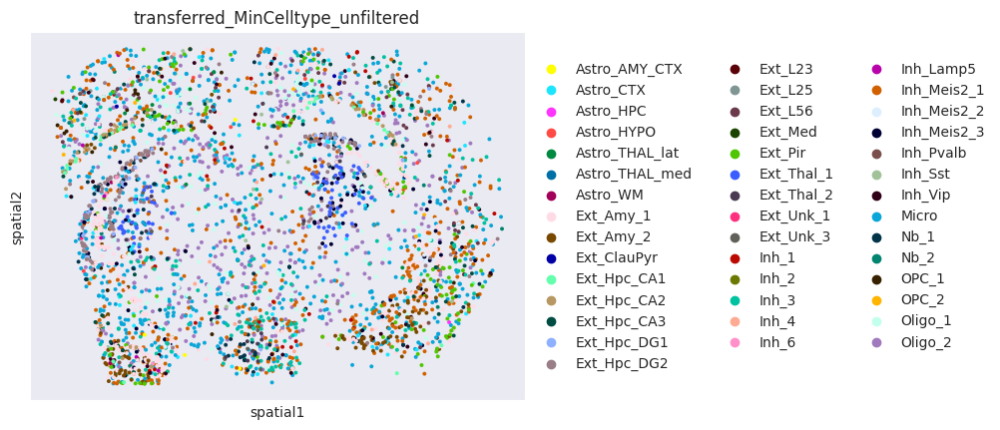

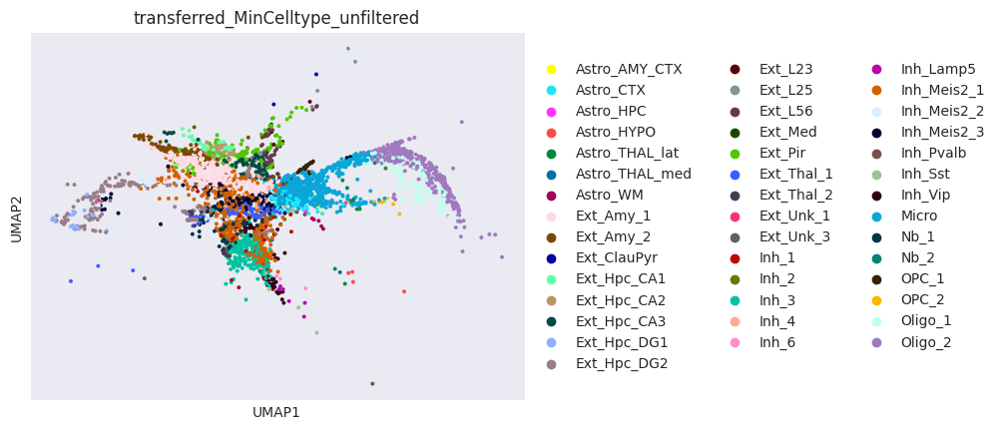

Running sample: WTH665


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 2812 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 37818
Number of validation nodes: 4202
Number of training edges: 124714
Number of validation edges: 13857
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9808; val_auprc_score: 0.9733; val_best_acc_score: 0.9419; val_best_f1_score: 0.9428; train_kl_reg_loss: 1141.0200; train_edge_recon_loss: 272990.7218; train_gene_expr_recon_loss: 133.3644; train_latent_contrastive_loss: 3.9

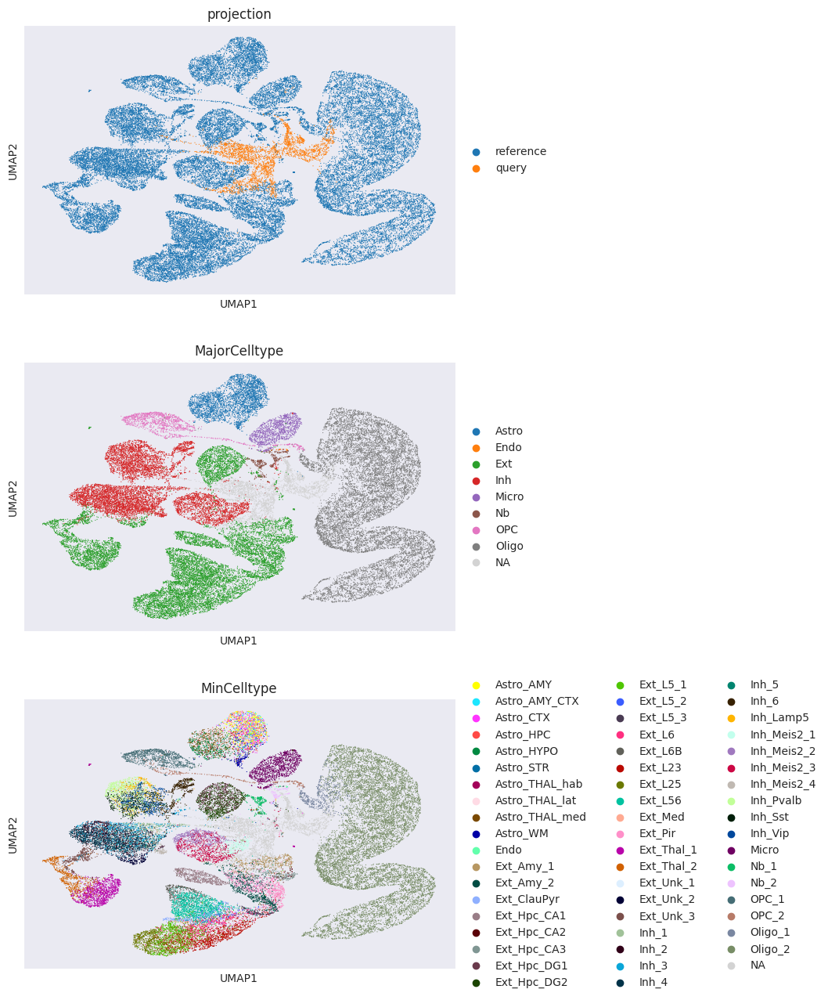

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


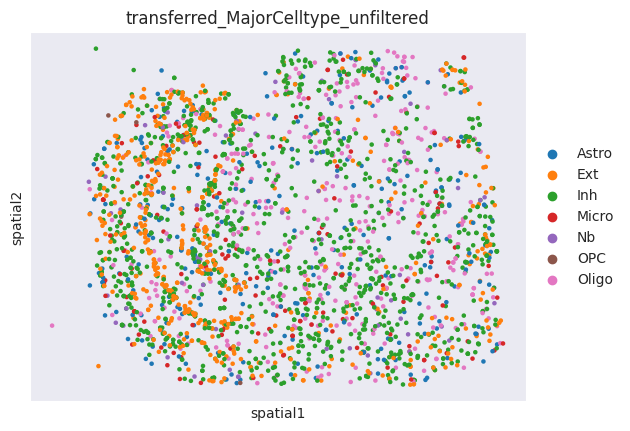

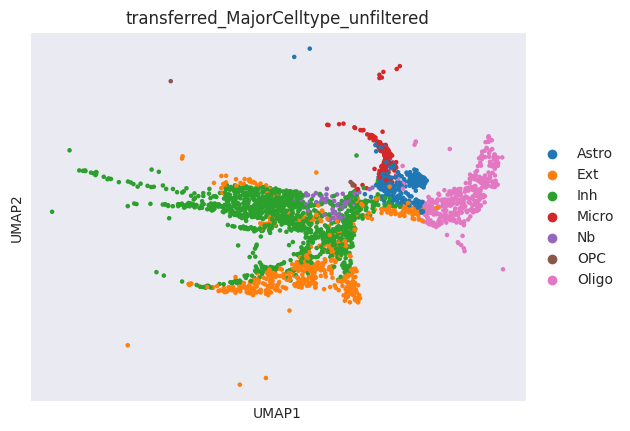

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


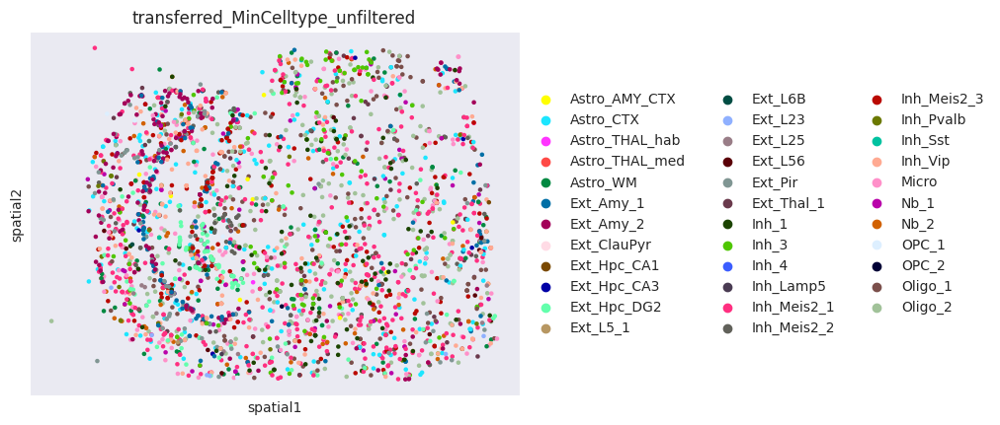

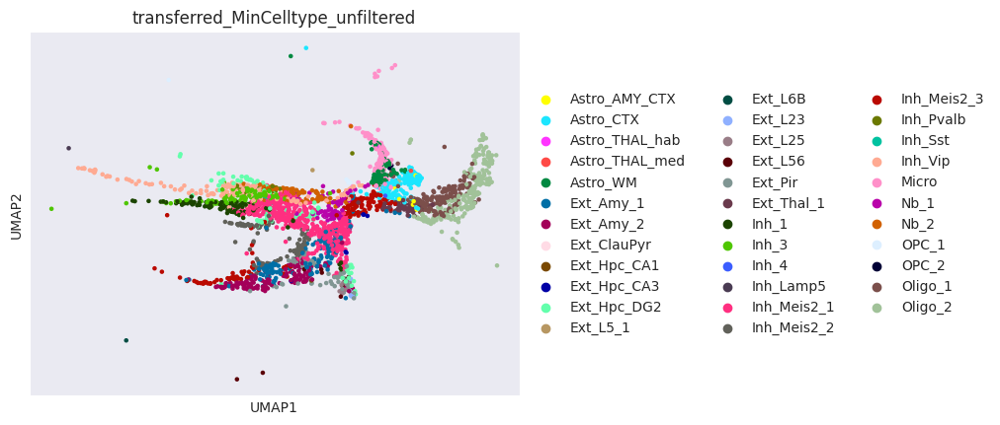

Running sample: WTH706


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 1399 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 36546
Number of validation nodes: 4061
Number of training edges: 120227
Number of validation edges: 13358
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9835; val_auprc_score: 0.9779; val_best_acc_score: 0.9482; val_best_f1_score: 0.9492; train_kl_reg_loss: 1070.5951; train_edge_recon_loss: 272958.8604; train_gene_expr_recon_loss: 131.9672; train_latent_contrastive_loss: 3.9

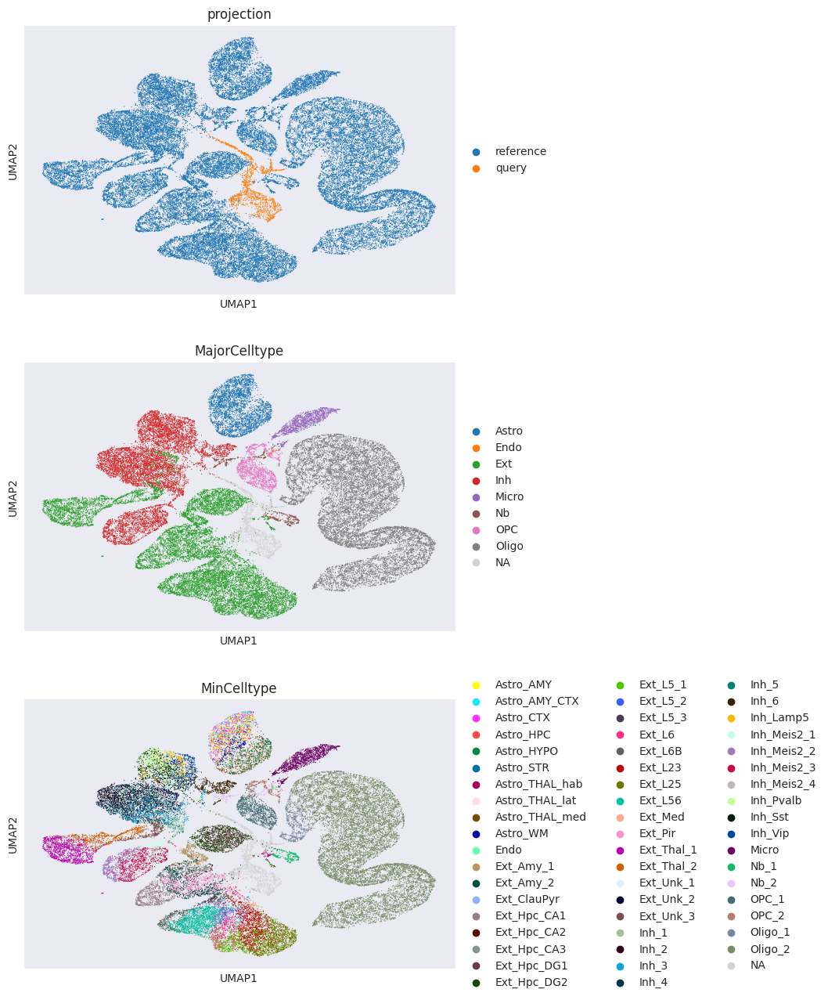

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


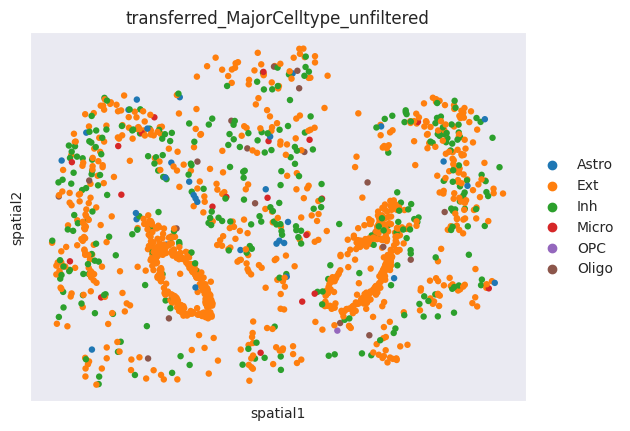

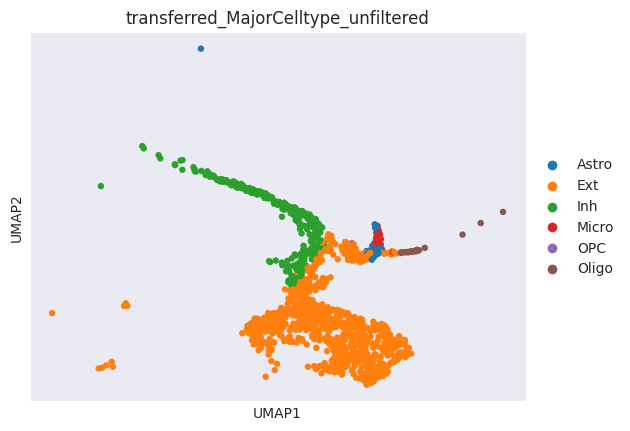

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


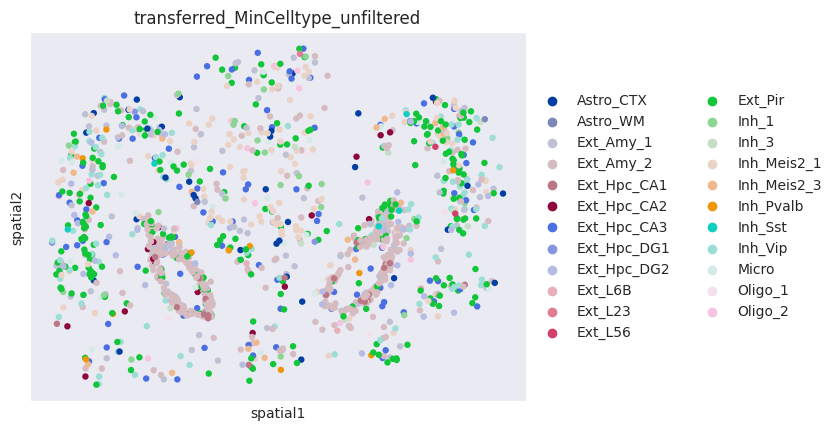

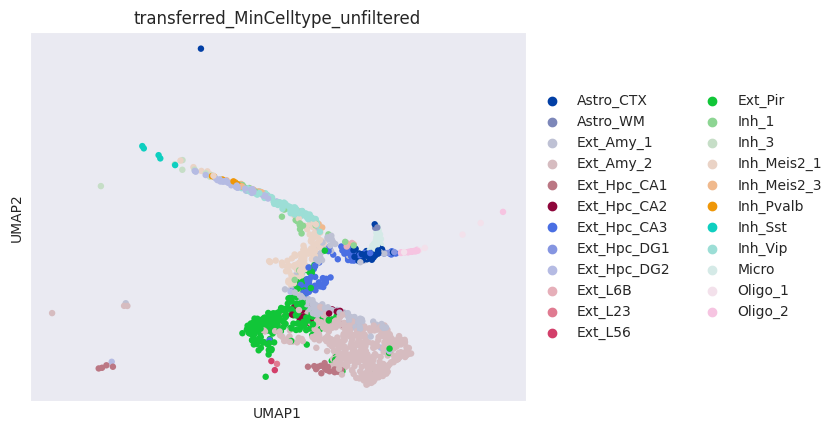

Running sample: WTH708


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 2837 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 37841
Number of validation nodes: 4204
Number of training edges: 124673
Number of validation edges: 13852
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9822; val_auprc_score: 0.9754; val_best_acc_score: 0.9489; val_best_f1_score: 0.9498; train_kl_reg_loss: 1024.5588; train_edge_recon_loss: 272957.9244; train_gene_expr_recon_loss: 132.9957; train_latent_contrastive_loss: 3.9

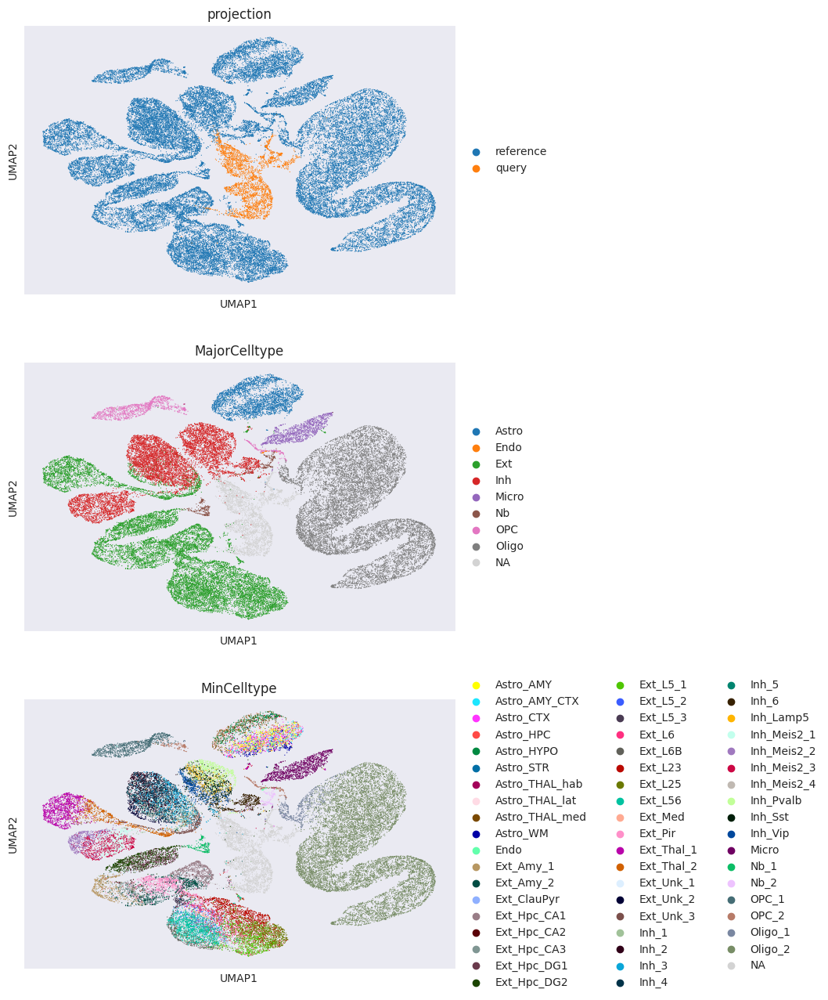

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


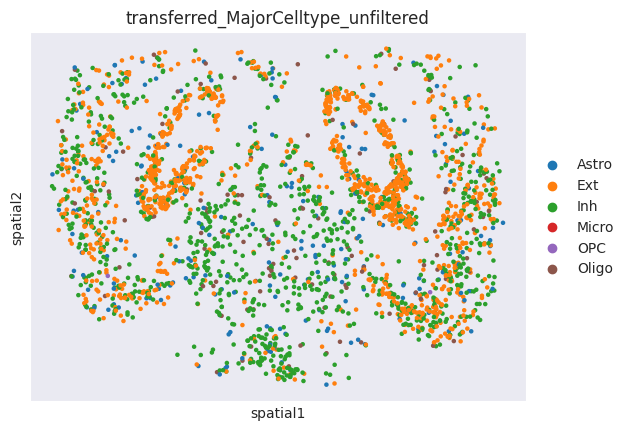

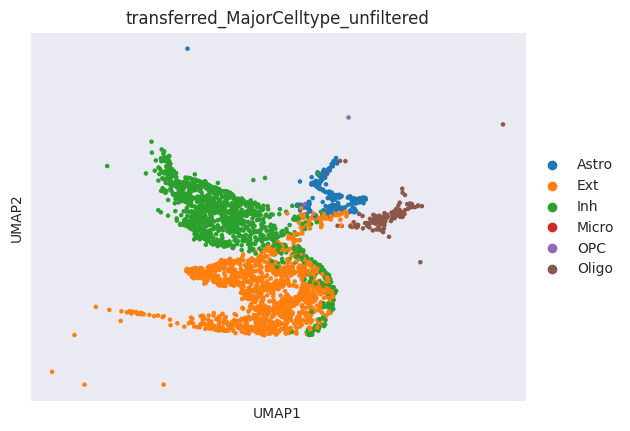

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


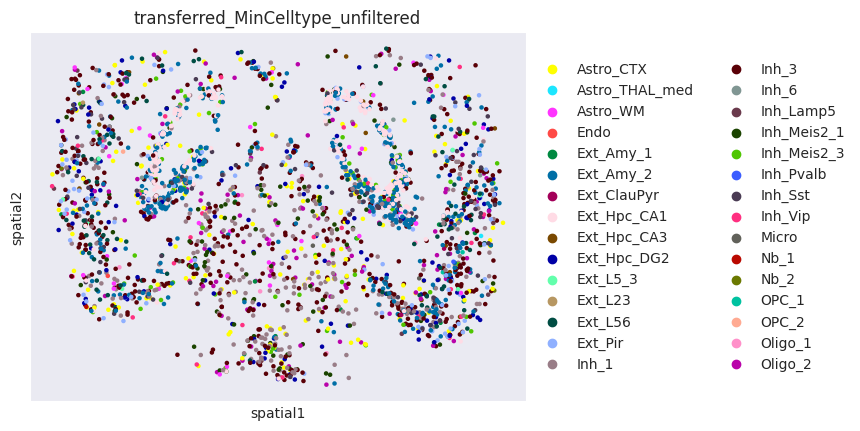

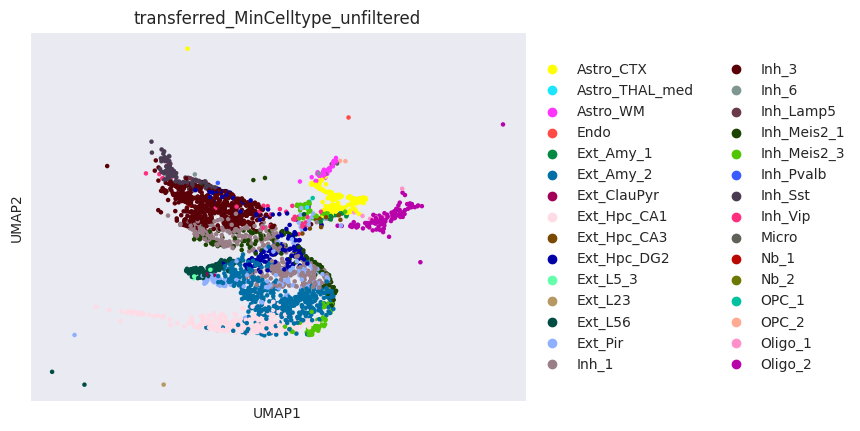

Running sample: WTH725


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 1638 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 36761
Number of validation nodes: 4085
Number of training edges: 121048
Number of validation edges: 13449
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9815; val_auprc_score: 0.9746; val_best_acc_score: 0.9436; val_best_f1_score: 0.9447; train_kl_reg_loss: 1084.7311; train_edge_recon_loss: 273186.8812; train_gene_expr_recon_loss: 132.5728; train_latent_contrastive_loss: 3.9

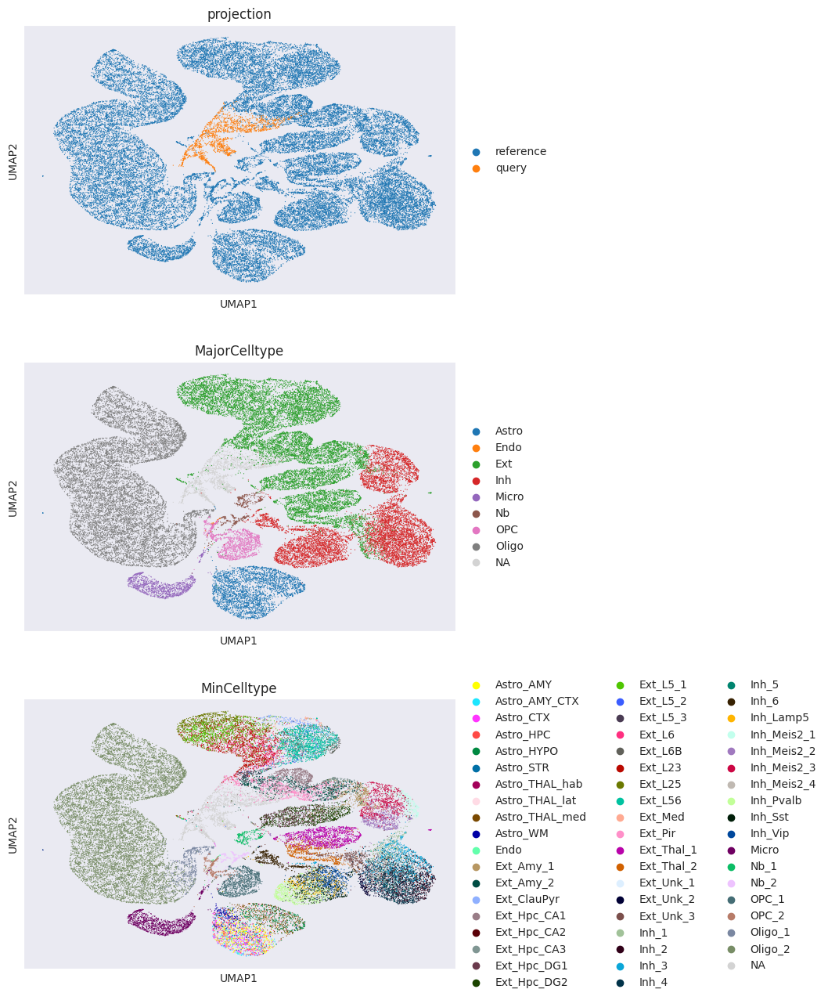

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


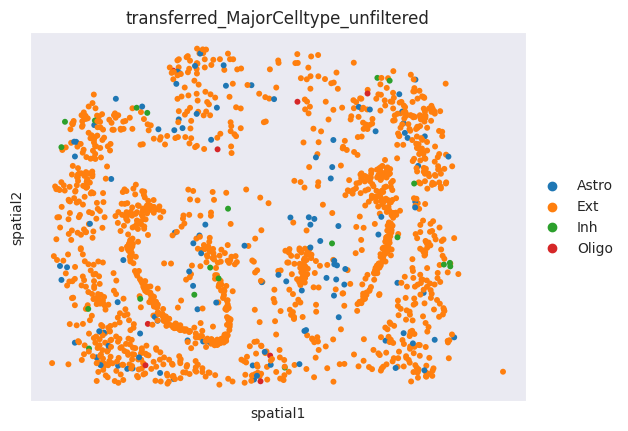

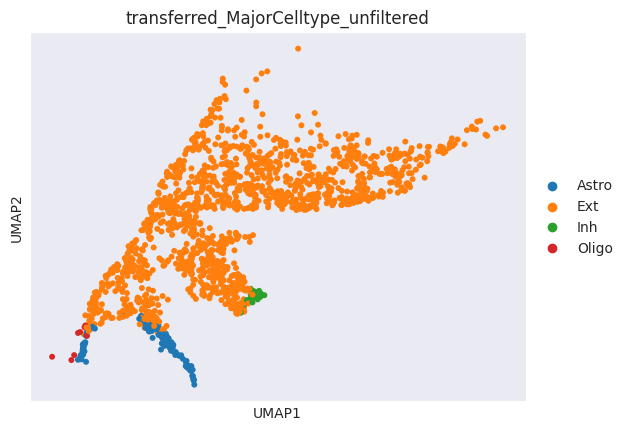

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


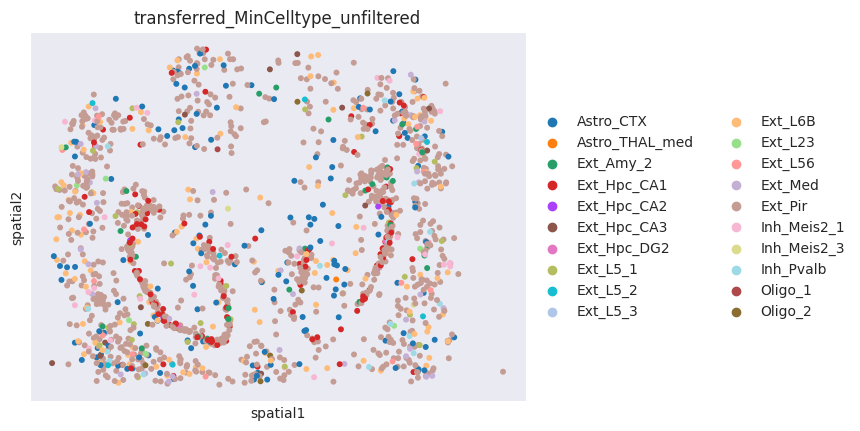

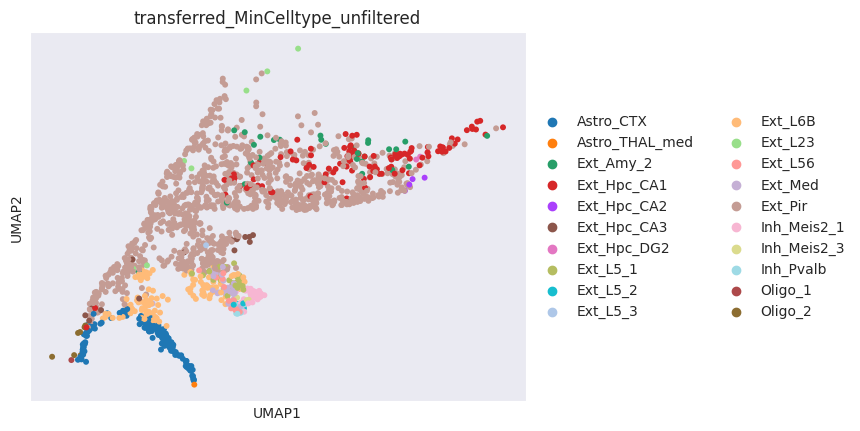

Running sample: WTH983


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 11604 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 45731
Number of validation nodes: 5081
Number of training edges: 149899
Number of validation edges: 16655
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9833; val_auprc_score: 0.9769; val_best_acc_score: 0.9462; val_best_f1_score: 0.9472; train_kl_reg_loss: 990.1210; train_edge_recon_loss: 273308.3184; train_gene_expr_recon_loss: 137.5561; train_latent_contrastive_loss: 3.9

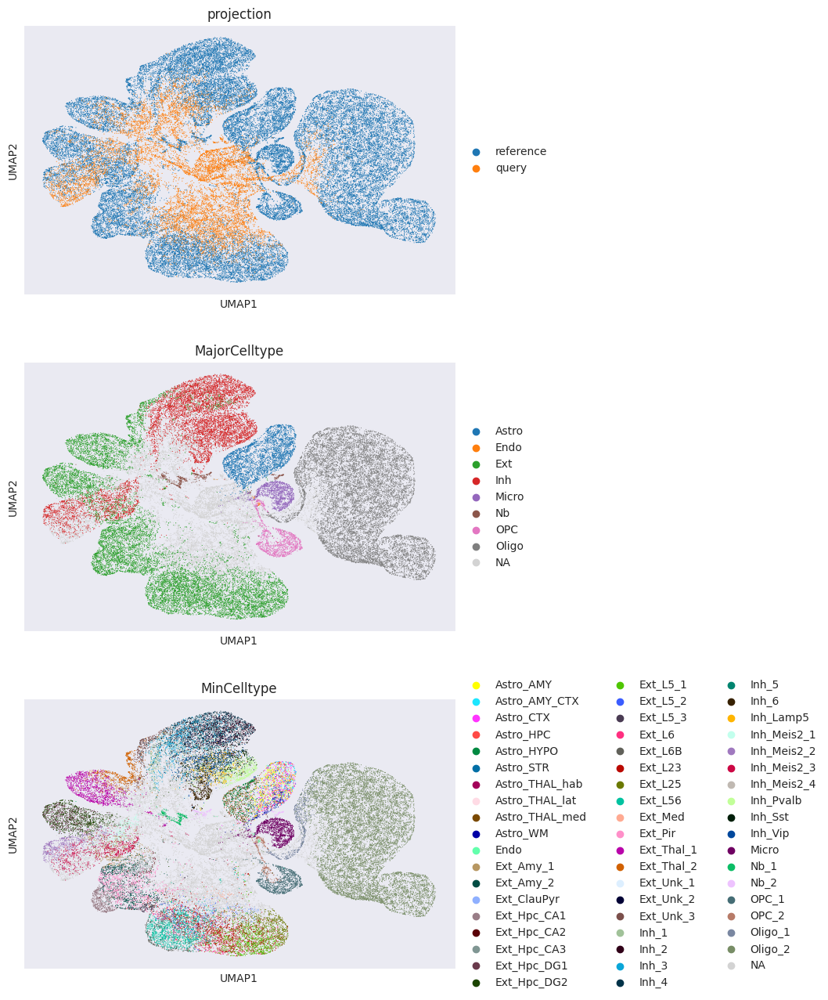

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


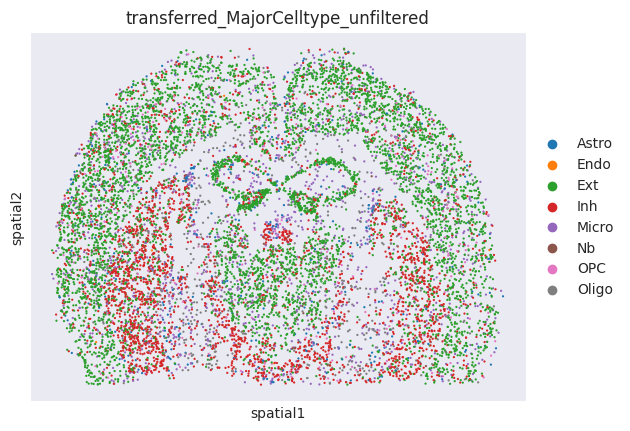

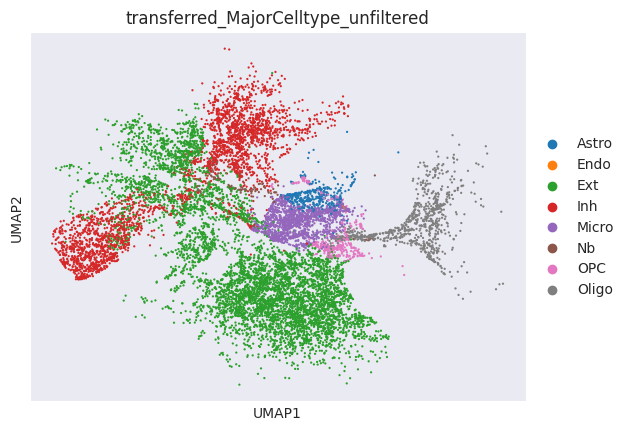

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


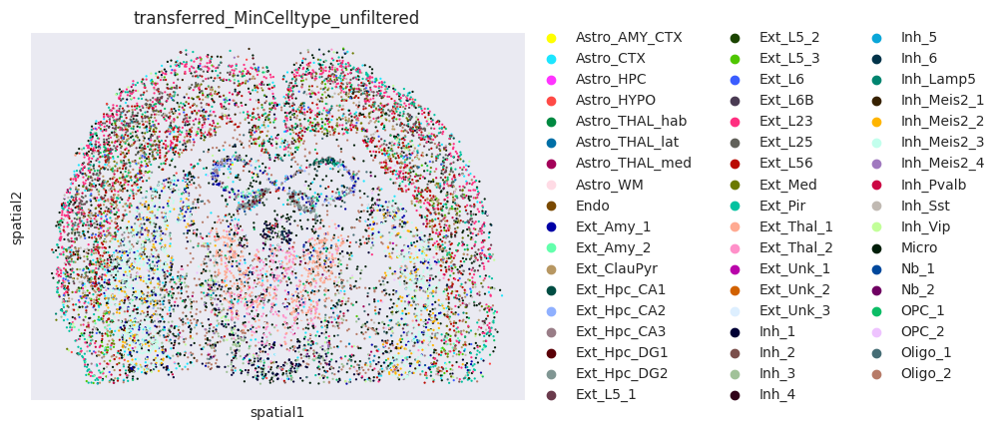

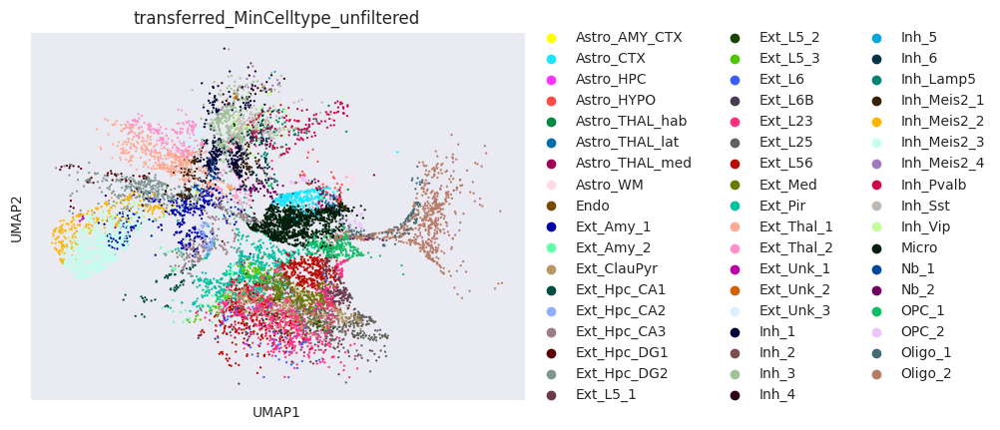

Running sample: WTH985


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Query data is missing expression data of  83  genes which were contained in the reference dataset.
The missing information will be filled with zeroes.
Query data contains expression data of  29368  genes that were not contained in the reference dataset. This information will be removed from the query data object for further processing.
AnnData object with n_obs × n_vars = 7635 × 3000
    obs: 'Batch'
--- DATA LOADING AND PREPROCESSING ---
COSINE SIM GRAPH DECODER -> dropout_rate: 0.2

--- INITIALIZING TRAINER ---
Number of training nodes: 42159
Number of validation nodes: 4684
Number of training edges: 138580
Number of validation edges: 15397
Edge batch size: 4096
Node batch size: 64

--- MODEL TRAINING ---
Epoch 1/100 |--------------------| 1.0% val_auroc_score: 0.9809; val_auprc_score: 0.9737; val_best_acc_score: 0.9422; val_best_f1_score: 0.9437; train_kl_reg_loss: 1036.8858; train_edge_recon_loss: 273191.3888; train_gene_expr_recon_loss: 134.2499; train_latent_contrastive_loss: 3.9

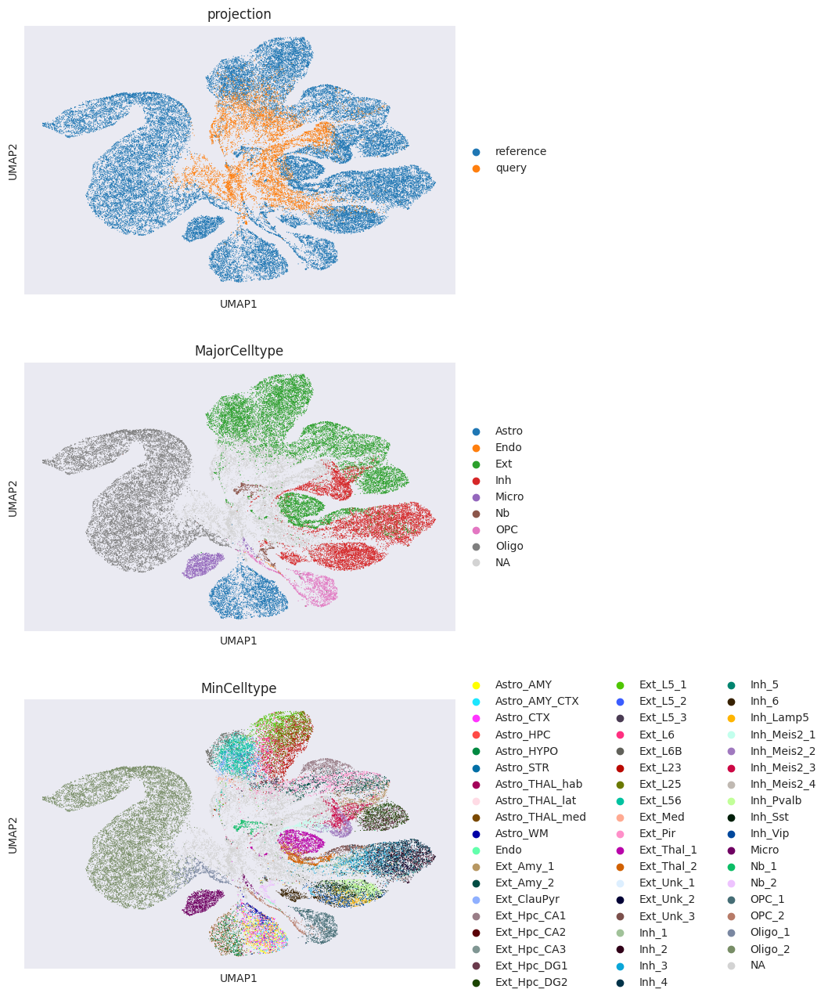

Weighted KNN with n_neighbors = 10 ... 
Label transfer finished!


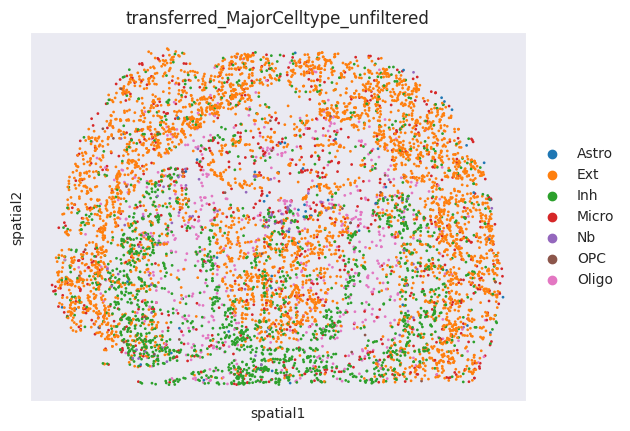

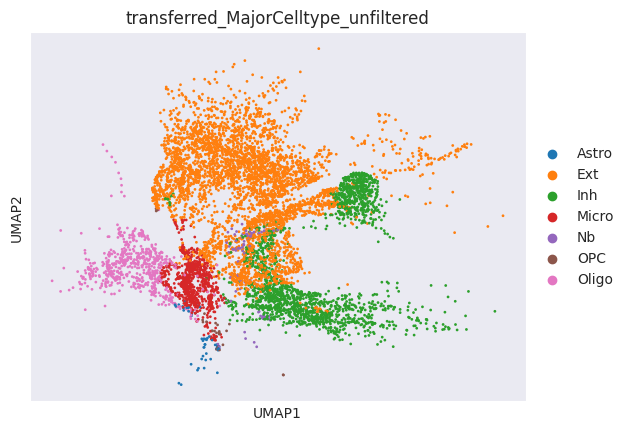

Weighted KNN with n_neighbors = 5 ... 
Label transfer finished!


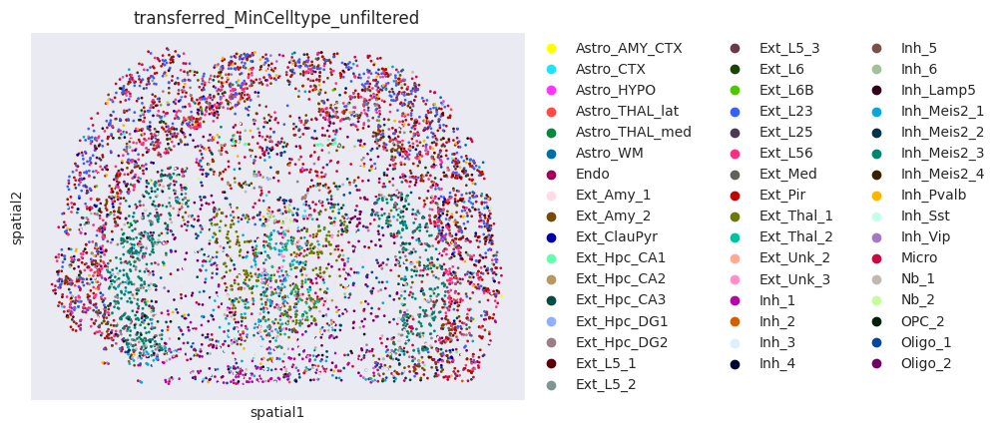

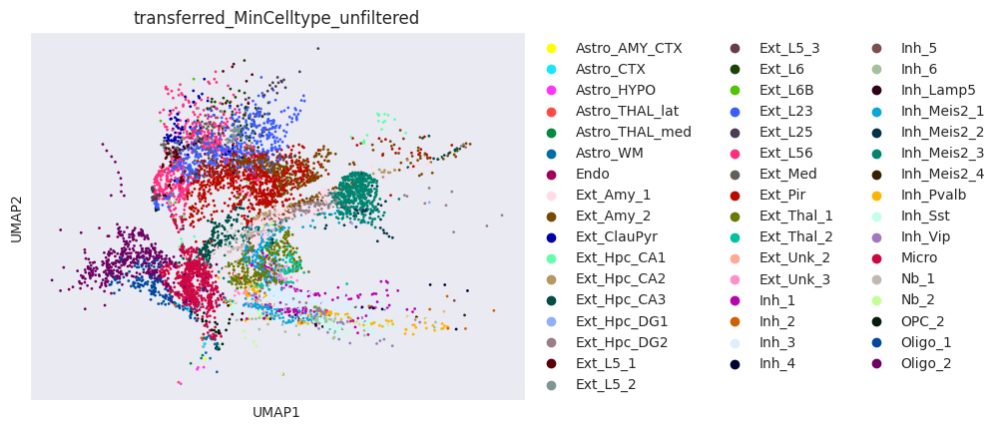

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [ ]:
## 循环批量跑
import scanpy as sc

for query_adata in adata_list:
    sample_name = query_adata.obs['Batch'].unique()[0]
    spatial_tmp = query_adata.obsm['spatial'].copy()

    print('Running sample: {}'.format(sample_name), flush=True)
    new_model = model.load_query_data(dir_path=model_folder_path,
                                      query_adata=query_adata,
                                      ref_adata_name="adata_ref.h5ad",
                                      use_cuda=True,
                                      unfreeze_all_weights=False,
                                      unfreeze_eps_weight=True,
                                      unfreeze_layer0=True,
                                      used_mmd=True)
    # Training and obtain latent representation
    new_model.train()

    # plot UMAP
    sc.pp.neighbors(new_model.adata, use_rep='garfield_latent')
    sc.tl.umap(new_model.adata)
    sc.pl.umap(new_model.adata, color=['projection', 'MajorCelltype', 'MinCelltype'],
               ncols=1, wspace=0.20, edges=False, save='_snRNA_concat_umap_{}.pdf'.format(sample_name))

    ## split
    adata_ref = new_model.adata[new_model.adata.obs['projection'] == 'reference', :]
    adata_query = new_model.adata[new_model.adata.obs['projection'] == 'query', :]

    ### Label transfer
    ## major celltype
    adata_query = new_model.label_transfer(ref_adata=adata_ref,
                                           ref_adata_emb='garfield_latent',
                                           query_adata=adata_query,
                                           query_adata_emb='garfield_latent',
                                           n_neighbors=10,
                                           ref_adata_obs=adata_ref.obs,
                                           label_keys='MajorCelltype')

    adata_query.obsm['spatial'] = spatial_tmp
    sc.pl.embedding(adata_query, basis="spatial",
                    color="transferred_MajorCelltype_unfiltered",
                    save='_snRNA_query_spatial_{}.pdf'.format(sample_name))

    sc.pl.umap(adata_query, color=['transferred_MajorCelltype_unfiltered'],
               ncols=1, wspace=0.20, edges=False,
               save='_snRNA_query_umap_{}.pdf'.format(sample_name))

    ## min celltype
    adata_query = new_model.label_transfer(ref_adata=adata_ref,
                                           ref_adata_emb='garfield_latent',
                                           query_adata=adata_query,
                                           query_adata_emb='garfield_latent',
                                           n_neighbors=5,
                                           ref_adata_obs=adata_ref.obs,
                                           label_keys='MinCelltype')

    sc.pl.embedding(adata_query, basis="spatial", color="transferred_MinCelltype_unfiltered",
                    save='_snRNA_queryMin_spatial_{}.pdf'.format(sample_name))
    sc.pl.umap(adata_query, color=['transferred_MinCelltype_unfiltered'],
               ncols=1, wspace=0.20, edges=False, save='_snRNA_queryMin_umap_{}.pdf'.format(sample_name))

    # 创建独热编码
    ## MajorCelltype
    # 删除其他列，只保留barcode和final_celltype
    final_df = adata_query.obs[['transferred_MajorCelltype_unfiltered']]
    cell_types = list(adata_query.obs['MajorCelltype'].unique())
    for cell_type in cell_types:
        final_df[cell_type] = (final_df['transferred_MajorCelltype_unfiltered'] == cell_type).astype(int)
    ## 保存结果
    final_df.to_csv(f"{workdir}/predict_label/pred_Major_{sample_name}.csv", sep=',', index=True, header=True)

    ## MinCelltype
    # 删除其他列，只保留barcode和final_celltype
    final_df = adata_query.obs[['transferred_MinCelltype_unfiltered']]
    cell_types = list(adata_query.obs['MinCelltype'].unique())
    for cell_type in cell_types:
        final_df[cell_type] = (final_df['transferred_MinCelltype_unfiltered'] == cell_type).astype(int)
    ## 保存结果
    final_df.to_csv(f"{workdir}/predict_label/pred_Min_{sample_name}.csv", sep=',', index=True, header=True)

In [26]:
import pandas as pd

for adata_vis in adata_list:
    sample_name = adata_vis.obs['Batch'].unique()[0]
    meta = pd.read_csv('./snRNA_barin_with_Garfield2/predict_label/pred_Min_{}.csv'.format(sample_name), index_col=0)
    meta = meta.drop(columns=['Unnamed: 2'])
    meta.rename(columns={'transferred_MinCelltype_unfiltered':'predict_MinCelltype'}, inplace = True)

    # 创建独热编码
    cell_types = list(adata_ref.obs['MinCelltype'].unique())
    for cell_type in cell_types:
        meta[cell_type] = (meta['predict_MinCelltype'] == cell_type).astype(int)

    ## 保存结果
    meta.to_csv(f"./snRNA_barin_with_Garfield2/predict_label/pred_Min_{sample_name}.csv", sep=',', index=True, header=True)

KeyError: "['Unnamed: 2'] not found in axis"

In [ ]:
for adata_vis in adata_list:
    sample_name = adata_vis.obs['Batch'].unique()[0]
    meta = pd.read_csv('./snRNA_barin_with_Garfield2/predict_label/pred_Major_{}.csv'.format(sample_name), index_col=0)
    meta = meta.drop(columns=['Unnamed: 2'])
    meta.rename(columns={'transferred_MajorCelltype_unfiltered':'predict_MajorCelltype'}, inplace = True)

    # 创建独热编码
    cell_types = list(adata_ref.obs['MajorCelltype'].unique())
    for cell_type in cell_types:
        meta[cell_type] = (meta['predict_MajorCelltype'] == cell_type).astype(int)

    ## 保存结果
    meta.to_csv(f"./snRNA_barin_with_Garfield2/predict_label/pred_Major_{sample_name}.csv", sep=',', index=True, header=True)

In [27]:
meta = pd.read_csv('./snRNA_barin_with_Garfield2/predict_label/pred_Min_{}.csv'.format(sample_name), index_col=0)
meta

,predict_MinCelltype,Ext_L25,Ext_L56,Ext_Thal_1,Ext_L5_1,Ext_Thal_2,Ext_L23,Oligo_2,Inh_1,Ext_Hpc_DG2,...,Astro_HPC,Ext_Hpc_CA2,Astro_WM,Inh_5,Astro_THAL_hab,Ext_Amy_1,Endo,Ext_Unk_3,Ext_Unk_2,Ext_Unk_1
TTTACCACGAGATTCGTCTAAGTACGA,Micro,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GTCGAATTACTAAACTGTAGTCATACG,Nb_2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AATGGAATACCCAGTGGAGCGACGGAT,Micro,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GGCACGTTACTATGCAACCTAATAACG,Astro_CTX,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TGTTTGTTACTAGATCAGCTCTGCTTC,OPC_1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CATGCGGTACATGGTACAAGGCACTAT,Ext_Amy_2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GGGTCTGCGATCGGTATTTCTGCGCTC,Ext_L23,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GAAATGATACCCTAACTGCTCTGCTTC,OPC_2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CATTGCCATGGTTCTATAAGGCACTAT,OPC_2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [28]:
import pandas as pd
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import label_binarize

def calculate_auc_from_csv(adata_list):
    results = {}

    for adata_vis in adata_list:
        sample_name = adata_vis.obs['Batch'].unique()[0]
        print('Calculating AUC for {}'.format(sample_name))

        # 创建 ground truth 和 predict 数据框
        df_ground_truth = pd.read_csv('/data2/zhouwg_data/bioData/Bio_OS_Data/analysis/results/MajorCellType/groundtruth/gold_{}.csv'.format(sample_name), index_col=0)
        df_predict = pd.read_csv('./snRNA_barin_with_Garfield2/predict_label/pred_Major_{}.csv'.format(sample_name), index_col=0)
        df_ground_truth = df_ground_truth[['predict_MajorCelltype']]
        df_predict = df_predict[['predict_MajorCelltype']]

        # 合并数据框以确保 ID 一致
        df = pd.merge(df_ground_truth, df_predict, left_index=True, right_index=True, suffixes=("_true", "_pred"))

        # 提取唯一的类别标签
        unique_classes = sorted(set(df["predict_MajorCelltype_true"]).union(set(df["predict_MajorCelltype_pred"])))

        # 二进制化类别标签
        y_true = label_binarize(df["predict_MajorCelltype_true"], classes=unique_classes)
        y_pred = label_binarize(df["predict_MajorCelltype_pred"], classes=unique_classes)

        # 计算每个类别的 AUC 值
        auc_scores = {}
        for i, class_name in enumerate(unique_classes):
            if len(np.unique(y_true[:, i])) > 1:  # 确保每个类别至少有一个正例和一个负例
                auc = roc_auc_score(y_true[:, i], y_pred[:, i])
                auc_scores[class_name] = auc
            else:
                print(f"Skipping AUC calculation for {class_name}: Not enough class instances.")

        # 存储结果
        results[sample_name] = auc_scores

    return results

In [29]:
## 大类 celltype AUC 计算
Major_results = calculate_auc_from_csv(adata_list)

Calculating AUC for WTH1039
Calculating AUC for WTH1058
Calculating AUC for WTH1060
Calculating AUC for WTH1064
Calculating AUC for WTH1079
Skipping AUC calculation for Nb: Not enough class instances.
Calculating AUC for WTH1092
Calculating AUC for WTH628
Calculating AUC for WTH645
Skipping AUC calculation for Nb: Not enough class instances.
Calculating AUC for WTH647
Calculating AUC for WTH665
Calculating AUC for WTH706
Skipping AUC calculation for Micro: Not enough class instances.
Calculating AUC for WTH708
Calculating AUC for WTH725
Calculating AUC for WTH983
Calculating AUC for WTH985


Text(0.5, 1.0, 'Boxplot of Values by Sample')

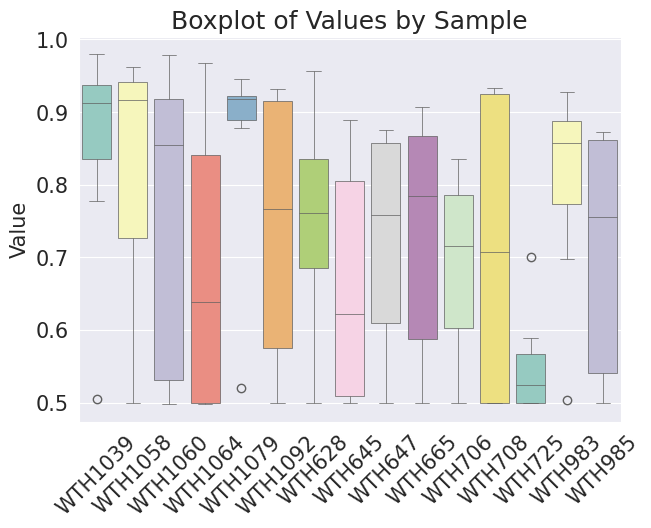

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

df = pd.DataFrame.from_dict(Major_results)
df['CellType'] = df.index
# 重塑数据为长格式
df_long = df.melt(id_vars=["CellType"], var_name="Sample", value_name="Value")

# plotting
plt.rcParams['figure.figsize'] = (7,5)
plt.rcParams['font.size'] = 15
# plt.rcParams['font.sans-serif'] = 'Arial'

## sample
ax = sns.boxplot(data=df_long, x='Sample', y='Value', linewidth=0.5, palette='Set3') # hue='CellType',

plt.xticks(rotation=45)
#plt.yticks(size=50)
ax.set_xlabel('')
ax.set_ylabel('Value')
ax.set_title('Boxplot of Values by Sample')
# plt.legend(loc='upper left', bbox_to_anchor=(1, 1.01))
# plt.savefig('./results/Sample_boxplot_{}.png'.format('MajorSample'), bbox_inches='tight')

Text(0.5, 1.0, 'Boxplot of Values by CellType')

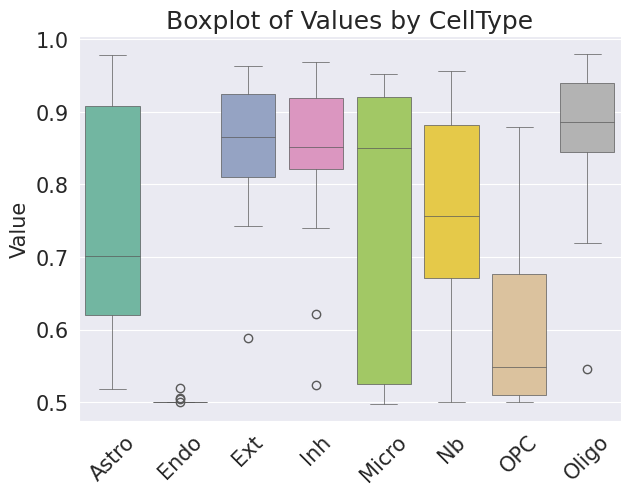

In [31]:
# plotting
plt.rcParams['figure.figsize'] = (7,5)
plt.rcParams['font.size'] = 15

## Celltype
ax = sns.boxplot(data=df_long, x='CellType', y='Value', linewidth=0.5, palette='Set2') # hue='CellType',

plt.xticks(rotation=45)
#plt.yticks(size=50)
ax.set_xlabel('')
ax.set_ylabel('Value')
ax.set_title('Boxplot of Values by CellType')
# plt.legend(loc='upper left', bbox_to_anchor=(1, 1.01))
# plt.savefig('./results/Sample_boxplot_{}.png'.format('MajorCellType'), bbox_inches='tight')

In [32]:
import pandas as pd
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import label_binarize

def calculate_auc_from_csv(adata_list):
    results = {}

    for adata_vis in adata_list:
        sample_name = adata_vis.obs['Batch'].unique()[0]
        print('Calculating AUC for {}'.format(sample_name))

        # 创建 ground truth 和 predict 数据框
        df_ground_truth = pd.read_csv('/data2/zhouwg_data/bioData/Bio_OS_Data/analysis/results/MinCellType/groundtruth/gold_{}.csv'.format(sample_name), index_col=0)
        df_predict = pd.read_csv('./snRNA_barin_with_Garfield2/predict_label/pred_Min_{}.csv'.format(sample_name), index_col=0)
        df_ground_truth = df_ground_truth[['predict_MinCelltype']]
        df_predict = df_predict[['predict_MinCelltype']]

        # 合并数据框以确保 ID 一致
        df = pd.merge(df_ground_truth, df_predict, left_index=True, right_index=True, suffixes=("_true", "_pred"))

        # 提取唯一的类别标签
        unique_classes = sorted(set(df["predict_MinCelltype_true"]).union(set(df["predict_MinCelltype_pred"])))

        # 二进制化类别标签
        y_true = label_binarize(df["predict_MinCelltype_true"], classes=unique_classes)
        y_pred = label_binarize(df["predict_MinCelltype_pred"], classes=unique_classes)

        # 计算每个类别的 AUC 值
        auc_scores = {}
        for i, class_name in enumerate(unique_classes):
            if len(np.unique(y_true[:, i])) > 1:  # 确保每个类别至少有一个正例和一个负例
                auc = roc_auc_score(y_true[:, i], y_pred[:, i])
                auc_scores[class_name] = auc
            else:
                print(f"Skipping AUC calculation for {class_name}: Not enough class instances.")

        # 存储结果
        results[sample_name] = auc_scores

    return results

In [33]:
## 亚类 celltype AUC 计算
Min_results = calculate_auc_from_csv(adata_list)

Calculating AUC for WTH1039
Skipping AUC calculation for Astro_AMY_CTX: Not enough class instances.
Skipping AUC calculation for Astro_HPC: Not enough class instances.
Skipping AUC calculation for Astro_THAL_hab: Not enough class instances.
Skipping AUC calculation for Astro_THAL_lat: Not enough class instances.
Skipping AUC calculation for Astro_THAL_med: Not enough class instances.
Skipping AUC calculation for Ext_Amy_1: Not enough class instances.
Skipping AUC calculation for Ext_Amy_2: Not enough class instances.
Skipping AUC calculation for Ext_Hpc_CA1: Not enough class instances.
Skipping AUC calculation for Ext_Hpc_DG2: Not enough class instances.
Skipping AUC calculation for Ext_L23: Not enough class instances.
Skipping AUC calculation for Ext_L5_1: Not enough class instances.
Skipping AUC calculation for Ext_L6: Not enough class instances.
Skipping AUC calculation for Ext_Med: Not enough class instances.
Skipping AUC calculation for Ext_Pir: Not enough class instances.
Skippin

Text(0.5, 1.0, 'Boxplot of Values by Sample')

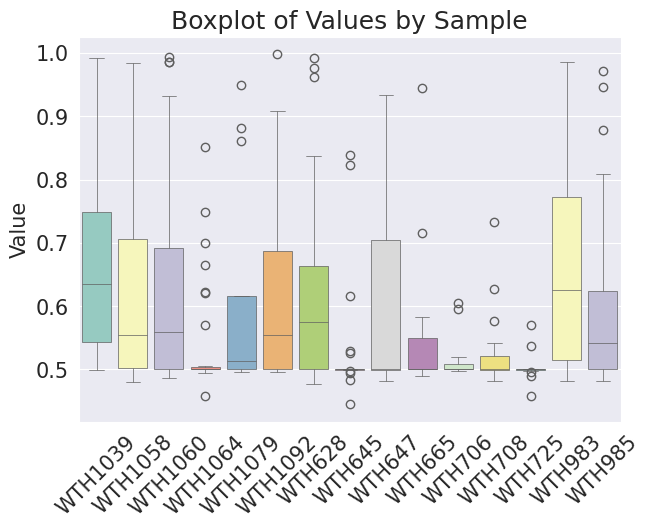

In [34]:
import seaborn as sns
import matplotlib.pyplot as plt

df = pd.DataFrame.from_dict(Min_results)
df['CellType'] = df.index
# 重塑数据为长格式
df_long = df.melt(id_vars=["CellType"], var_name="Sample", value_name="Value")

# plotting
plt.rcParams['figure.figsize'] = (7,5)
plt.rcParams['font.size'] = 15
# plt.rcParams['font.sans-serif'] = 'Arial'

## sample
ax = sns.boxplot(data=df_long, x='Sample', y='Value', linewidth=0.5, palette='Set3') # hue='CellType',

plt.xticks(rotation=45)
#plt.yticks(size=50)
ax.set_xlabel('')
ax.set_ylabel('Value')
ax.set_title('Boxplot of Values by Sample')
# plt.legend(loc='upper left', bbox_to_anchor=(1, 1.01))
# plt.savefig('./results/Sample_boxplot_{}.png'.format('MinSample'), bbox_inches='tight')

Text(0.5, 1.0, 'Boxplot of Values by CellType')

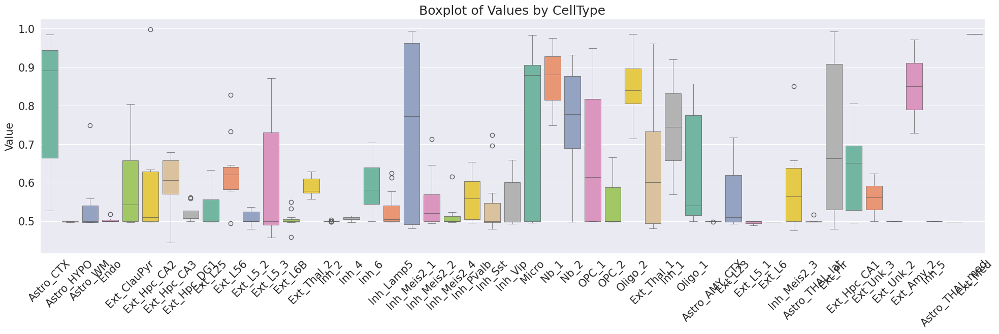

In [35]:
# plotting
plt.rcParams['figure.figsize'] = (24,6)
plt.rcParams['font.size'] = 15

## Celltype
ax = sns.boxplot(data=df_long, x='CellType', y='Value', linewidth=0.5, palette='Set2') # hue='CellType',

plt.xticks(rotation=45)
#plt.yticks(size=50)
ax.set_xlabel('')
ax.set_ylabel('Value')
ax.set_title('Boxplot of Values by CellType')
# plt.legend(loc='upper left', bbox_to_anchor=(1, 1.01))
# plt.savefig('./results/Sample_boxplot_{}.png'.format('MinCellType'), bbox_inches='tight')